# 0. Necessary Imports
Import all the necessary packages for this assignment. **ONLY PYTORCH MODELS ARE ACCEPTED!**

In [1]:
# ADD YOUR CODE HERE
#Import Necessary Libraries
import torch
import os
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

/home/syma/.local/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Assignment 1 - Simplified Custom Object Detection

This notebook contains the required task for the first assignment of the Deep Network Development course. Read the task description and fill in the empty code cells. Each section represents an implementation stage of object detection: -from `loading and inspecting the dataset`; -to `implementing`, `training and evaluating a Convolutional Neural Network based architecture`. The sections are there to guide you but you do not have to follow them strictly.

Copy this notebook to your drive (File -> Save a copy in Drive), edit it, and upload the final .ipynb file to [Canvas](https://canvas.elte.hu). If you are using this in Google Colab notebook, save it as .ipynb and upload it, or share the public link. If you have your own machine with Jupyter installed, you can work there as well, as long as you save and upload the .ipynb file.


## General Rules
Please check all the requirements listed on Canvas, but here are some general rules:
- Please select at least ANY 3 objects of choice. Try to pick unique objects. You may pick more, but less than 3 is not acceptable and results in losing points;
- While we do not require a high performance model, we still expect you to have a model that performs better than "random guessing" (i.e. for 3 objects, mAP should be better than 33%);
- Copying others' code will make you fail the assignment automatically, resulting in a 0;
- Not submitting anything results in a 0;
- Submitting something, as long as it is not an empty notebook, might result in a 1;
- **Deadline is October 25th Friday 11:59 PM** (strict, no late submission)
- Feel free to add more code cells as needed. But don't put code into external Python files.
- Please add your name, Neptun ID, and task details below.

**Name:*Syma Afsha*  

**Neptun ID:*DGLTNJ*

**Network:*Custom CNN Object Detection Model*

**Objects:*Panda, Lion, Book*

## Task description

**Your task** is to train your own custom object detection model and compare its performance with an existing object detection model (i.e., YOLO). For that, you need to generate a synthetic dataset to train your own custom model and fine-tune an existing one. This is a simplified version of object detection, where each image must only contain a single object.

- There is no expectation of high performance, but **your metrics should show results better than random guessing, and your loss must decrease throughout the epochs**.

- We expect you to visualize the key metrics such as precision, recall, F1-score, mAP (mean average precision), IoU (Intersection over Union), and localization loss, in addition to monitoring the overall loss and its reduction across training. Use plots and visualizations (e.g., matplotlib, seaborn) to display metrics, losses, and predictions.

- You should implement techniques to avoid overfitting, such as Early Stopping, and save the best-performing model during training.

- Additionally, you can use **WandB (Weights and Biases)** or **TensorBoard** to track and visualize training progress, monitor the model's performance, and log metrics over time.

`Good luck!`

**In order to get your grade for the assignment, you must defend it by answering questions during the designated practice time.**

## Guidelines
Please carefully read each cell of the notebook, as they contain guidelines to help you complete the assignments. While you don't have to follow them strictly, we believe that they provide enough help.

# 1. DATASET
**For this assignment you are free to pick any 3 objects of your choice.** Please avoid offensive, inappropriate or violent objects.

### 1.1. Load objects

**Please select 3 or more objects.** After selecting the objects, **remove the background, keeping only the object itself**. You can do this manually, online, or by using code (this step is not part of the assignment evaluation).

As an example, the following objects were chosen (with the background removed using the Segment Anything Model):

In [2]:
!pip install rembg

In [3]:
!mkdir objects

mkdir: cannot create directory ‘objects’: File exists



##### rembg is a Python library specifically designed for removing backgrounds from images. It utilizes deep learning models to separate the foreground (main object) from the background, producing an image with a transparent background. 

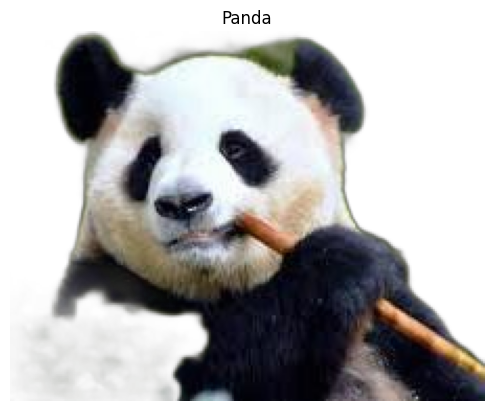

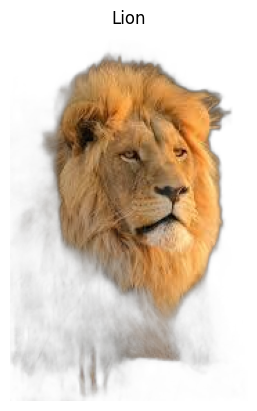

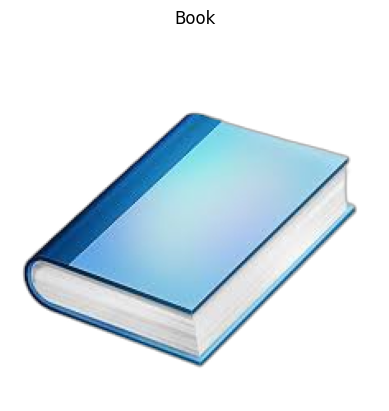

In [4]:
import os
from rembg import remove  
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt

# List of object image paths
image_path = ["panda.jpeg", "lion.jpeg", "book.jpeg"]
output_dir = "objects"
os.makedirs(output_dir, exist_ok=True)


# Loop through each image path
for i in image_path:
    # Check if the file exists
    if not os.path.exists(i):
        print(f"File {i} does not exist. Skipping.")
        continue

    # Open the image using PIL
    image = Image.open(i)

    # Convert the PIL image to binary data for rembg
    buffered = BytesIO()
    image.save(buffered, format="PNG")
    image_data = buffered.getvalue()

    # Apply the rembg background removal
    result = remove(image_data)

    # Convert the result back to a PIL image
    image_no_bg = Image.open(BytesIO(result))

    # Extract just the name of the file
    image_name = os.path.splitext(os.path.basename(i))[0]

    # Save the image with the background removed and resized
    image_no_bg_path = f"{image_name}.png"
    save_path = os.path.join(output_dir, image_no_bg_path)
    
    # Save the resized image
    image_no_bg.save(save_path)

    # Display the resized image using matplotlib
    plt.imshow(image_no_bg)
    plt.title(f'{image_name.capitalize()}')  # Capitalize the first letter of the name
    plt.axis('off')
    plt.show()


### 1.2. Load backgrounds

In order to train a custom object detection model, a dataset is needed. For this assignment, a synthetic dataset should be created by:

- **Inserting an object in a random position** on a background image.

**Therefore, collect a few background images from different locations** This can be done manually or via code.

It is recommended to use **icrawler** to automate the image collection process.


In [5]:
!pip install icrawler

In [6]:
!mkdir background

mkdir: cannot create directory ‘background’: File exists


In case of any errors, try using a different crawler. You can use one of the following options:

```python
from icrawler.builtin import BaiduImageCrawler, BingImageCrawler, GoogleImageCrawler


In [7]:
from icrawler.builtin import GoogleImageCrawler

google_crawler = GoogleImageCrawler(
    parser_threads=2,
    downloader_threads=4,
    storage={'root_dir': 'background'}
)

for keyword in ['budapest', 'budapest parliament', 'buda castle', 'budapest st stephen basilica', 'budapest heroes square']:
    google_crawler.crawl(
        keyword=keyword, max_num=10, file_idx_offset='auto') #, min_size=(500, 500),)



2024-10-22 23:33:13,355 - INFO - icrawler.crawler - start crawling...
2024-10-22 23:33:13,355 - INFO - icrawler.crawler - starting 1 feeder threads...
2024-10-22 23:33:13,356 - INFO - feeder - thread feeder-001 exit
2024-10-22 23:33:13,356 - INFO - icrawler.crawler - starting 2 parser threads...
2024-10-22 23:33:13,357 - INFO - icrawler.crawler - starting 4 downloader threads...
2024-10-22 23:33:14,678 - INFO - parser - parsing result page https://www.google.com/search?q=budapest&ijn=0&start=0&tbs=&tbm=isch
2024-10-22 23:33:15,357 - INFO - parser - no more page urls for thread parser-002 to parse
2024-10-22 23:33:15,358 - INFO - parser - thread parser-002 exit
2024-10-22 23:33:15,461 - ERROR - downloader - Response status code 404, file https://upload.wikimedia.org/wikipedia/commons/thumb/6/60/Budapest_Hungarian_Parliament_%2831363963556%29.jpg
2024-10-22 23:33:15,928 - INFO - downloader - image #1	https://www.barcelo.com/guia-turismo/wp-content/uploads/2022/10/Budapest-1.jpg
2024-10-2

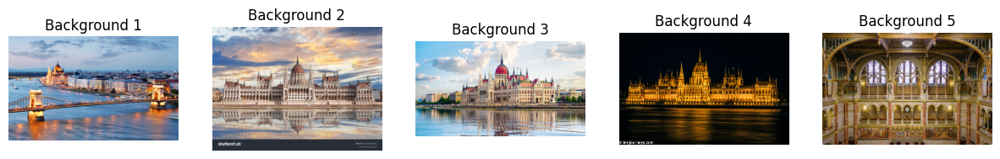

In [8]:
directory = 'background'

def display_sample_images(directory, num_images=5):
    # ADD YOUR CODE HERE
    # Create a list to store image file names
    image_files = []
    
    for f in os.listdir(directory):
        if f.endswith(('.jpg', '.jpeg', '.png')):
            image_files.append(f)
            
    # Limit the number of images to display
    image_files = image_files[:num_images]
    
    # Create a figure for displaying the images
    fig, axs = plt.subplots(1, len(image_files), figsize=(15, 5))
    for i, file in enumerate(image_files):
         # Open the image
        image_path = os.path.join(directory, file)
        image = Image.open(image_path)

        # Display the image
        axs[i].imshow(image)
        axs[i].set_title(f'Background {i + 1}')
        axs[i].axis('off')  

    plt.show()

display_sample_images(directory)

### 1.3. Create dataset

### Dataset Creation

This is a crucial part of the assignment evaluation. From the selected objects and collected background images, follow these steps to generate your dataset:

1. **Randomly select background images** from your collection.
2. **Insert a single object** (from the three selected) into each background image at a **random location**.
3. **Record the object's coordinates** and create a corresponding bounding box. For example:
   - If an object with height `h` and width `w` is placed at position `(x, y)`, the bounding box should be in one of the following formats:
     - **[x, y, w, h]** or
     - **[x1, y1, x2, y2]**, where `x2 = x1 + w` and `y2 = y1 + h`.
4. If you plan to compare your custom model with a YOLO model, use the **YOLO bounding box format**:
   - `[(x + w/2)/image_width, (y + h/2)/image_height, w/image_width, h/image_height]`, where `image` refers to the background image dimensions.
5. **Save the generated dataset**, as it will be used for training your custom model and fine-tuning the existing object detection model.
6. **Wrap the dataset creation** in a **PyTorch Dataset class** for easier data handling and model training.
7. **Split the dataset** into training, validation, and test sets to evaluate your model effectively.


In [9]:
def make_dirs(base_dir):
    # Create directories for the dataset
    os.makedirs(os.path.join(base_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(base_dir, 'labels'), exist_ok=True)

def yolo_bbox(x, y, w, h, img_width, img_height):
    # Convert bounding box to YOLO format (normalized [x_center, y_center, width, height])
    x_center = (x + w / 2) / img_width
    y_center = (y + h / 2) / img_height
    bbox_width = w / img_width
    bbox_height = h / img_height
    return [x_center, y_center, bbox_width, bbox_height]

def save_yolo_label(label_path, class_idx, bbox):
    # Save the YOLO label (class index and bounding box) to a text file
    with open(label_path, 'w') as label_file:
        label_file.write(f"{class_idx} {bbox[0]} {bbox[1]} {bbox[2]} {bbox[3]}\n")

In [10]:
import random
# Dictionary for object classes
object_classes = {
    "panda": 0,
    "lion": 1,
    "book": 2
}

def createDataset(root_dir, dataset_name, split, img_size, num_images):
    
    
    #This my own function... It creates and saves a dataset in the following format:
    # root/
    #     dataset/
    #             train/
    #                   images/
    #                         00001.jpg
    #                   labels/
    #                         00001.txt with the content [class yolo_x, yolo_y, yolo_w, yolo_h] following the yolo format
    #             val
    #...
    # ADD YOUR CODE HERE
    
    
    """
    Generates a dataset and saves it in the following format:
    root/
        split/  (train/val/test)
            images/   (image files go here)
            labels/   (YOLO labels go here)
    """
    # Define the path for the current dataset split 
    dataset_path = os.path.join(root_dir, split)
    # Create the necessary directories 
    make_dirs(dataset_path)
    
    # Lists to store background and object image file paths
    object_image_files = []
    background_image_files = []

    # Load background and object files
    directory = ["background", "objects"]
    for dir_name in directory:
         # Loop over files in each directory
        for f in os.listdir(dir_name):
            # Check if the file is an image (.jpg/.jpeg/.png)
            if f.endswith(('.jpg', '.jpeg', '.png')):
                # Add background images to the background list
                if dir_name == "background":
                    background_image_files.append(os.path.join(dir_name, f))
                elif dir_name == "objects":
                     # Add object images to the object list
                    object_image_files.append(os.path.join(dir_name, f))
    
     # Loop to generate the required number of images for the dataset
    for i in range(1, num_images + 1):
        # Randomly select a single object and background
        obj_path = random.choice(object_image_files)
        bg_path = random.choice(background_image_files)
        
        # Open the object and background images
        obj_img = Image.open(obj_path).convert("RGBA")  # Convert to RGBA to handle transparency
        bg_img = Image.open(bg_path).convert("RGB")  # Convert to RGB for background
        
        
        # Resize background image
        bg_img = bg_img.resize(img_size)
        bg_width, bg_height = bg_img.size
        
        # Get object size
        obj_width, obj_height = obj_img.size
       
        
        # Ensure the object is placed fully within the background
        x = random.randint(0, bg_width - obj_width)
        y = random.randint(0, bg_height - obj_height)
        
        # Paste the object into the background at random location
        bg_img.paste(obj_img, (x, y), obj_img)
        
        # Convert the resulting image back to RGB (removing alpha channel)
        bg_img = bg_img.convert("RGB")
   
        # Save the image to the 'images' directory
        img_save_path = os.path.join(dataset_path, 'images', f'{i:05}.jpg')
        bg_img.save(img_save_path)
        
        # Extract the object name  from the file name
        obj_name = os.path.splitext(os.path.basename(obj_path))[0]
        
        # Get the class index for the object
        class_idx = object_classes.get(obj_name)

        # Calculate YOLO format bounding box
        bbox = yolo_bbox(x, y, obj_width, obj_height, bg_width, bg_height)
        
        # Save the label in the 'labels' directory
        label_save_path = os.path.join(dataset_path, 'labels', f'{i:05}.txt')
        save_yolo_label(label_save_path, class_idx, bbox)
        
    print(f"Finished generating {split} dataset with {num_images} images.")


createDataset('dataset', 'background', split='train', img_size=(640,640), num_images=5000)
createDataset('dataset', 'background', split='val', img_size=(640,640), num_images=1000)
createDataset('dataset', 'background', split='test', img_size=(640,640), num_images=200)

Finished generating train dataset with 5000 images.
Finished generating val dataset with 1000 images.
Finished generating test dataset with 200 images.


In [11]:
class ObjectDetectionDataset(Dataset):
    def __init__(self, root_dir, split, num_classes=3, transform=None):
    
        # Initializes the custom dataset for object detection.
        self.root_dir = root_dir
        self.split_dir = os.path.join(root_dir, split)
        self.image_dir = os.path.join(self.split_dir, 'images')
        self.label_dir = os.path.join(self.split_dir, 'labels')
        self.image_filenames = sorted(os.listdir(self.image_dir))
        self.transform = transform
        self.num_classes = num_classes

    def __len__(self):
        # Returns the total number of images in the dataset.
        return len(self.image_filenames)

    def __getitem__(self, idx):
        # Fetches the image and its corresponding labels (bounding boxes and classes) for a given index.
        image_name = self.image_filenames[idx]
        image_path = os.path.join(self.image_dir, image_name)
        label_path = os.path.join(self.label_dir, image_name.replace('.jpg', '.txt'))
        
         # Load the image using PIL and convert to RGB
        image = Image.open(image_path).convert("RGB")
        img_width, img_height = image.size
        ## List to hold Categories and BBOX
        categories = []
        bboxes = []

        # Load the labels  from the YOLO format file
        if os.path.exists(label_path):
            with open(label_path, "r") as file:
                # Read all the lines from the label file
                label_data = file.readlines()

            for line in label_data:
                # Split the line into class index and bounding box values
                label_parts = line.strip().split()

                 # Check if there are at least 5 parts (class index + 4 bbox coordinates)
                if len(label_parts) < 5:
                    print(f"Invalid label format: {label_parts}")
                    continue

                # Extract the class index of the first element
                class_idx = int(label_parts[0])  
                categories.append(class_idx)
                # Extract the bounding box values
                x_center, y_center, width, height = map(float, label_parts[1:])
                
                # Convert YOLO format (x_center, y_center, width, height) to (x1, y1, x2, y2)
                x1 = (x_center - width / 2) * img_width
                y1 = (y_center - height / 2) * img_height
                x2 = (x_center + width / 2) * img_width
                y2 = (y_center + height / 2) * img_height
                bboxes.append([x1, y1, x2, y2])
                
        else:
            print(f"Label file not found for image: {image_name}")
        
        # Apply transformations if provided 
        if self.transform:
             # Transform the image and bounding boxes using the provided transformations
            transformed = self.transform(
                **{
                    'image': np.array(image), # Convert the PIL image to a NumPy array
                    'bboxes': bboxes, # Provide bounding boxes
                    'labels': categories # Provide class indices
                }
            )
            image = transformed['image']
            bboxes = transformed['bboxes']
            categories = transformed['labels']
        
        else:
            # Use transforms.ToTensor() to convert to float32 automatically
            image = transforms.ToTensor()(image).float()

        # Convert categories and bounding boxes to tensors, handle empty annotations
        if len(categories) > 0:
            categories = torch.tensor([int(cat) for cat in categories], dtype=torch.long)
            bboxes = torch.tensor(bboxes, dtype=torch.float32)
        else:
            # If no objects are found, return empty tensors for categories and bounding boxes
            categories = torch.tensor([], dtype=torch.long)  
            bboxes = torch.tensor([], dtype=torch.float32).view(-1, 4) 
        return image, categories, bboxes


In [12]:
!pip install --upgrade albumentations

Requirement already up-to-date: albumentations in /home/syma/.local/lib/python3.8/site-packages (1.4.18)


In [13]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Define augmentations with bounding box support for training
transform = A.Compose([
    # Randomly flip the image and bounding boxes horizontally with a 50% probability
    A.HorizontalFlip(p=0.5),
    
     # Randomly rotate the image by 90 degrees with a 50% probability
    A.RandomRotate90(p=0.5), 
    
    # Randomly change brightness, contrast, saturation, and hue of the image with a 50% probability
    A.ColorJitter(p=0.5),
    
    # Randomly mask out rectangular regions of the image , to simulate occlusion and prevent overfitting.
    A.CoarseDropout(max_holes=8, max_height=16, max_width=16, min_holes=1, p=0.5),
    # A.Resize(640, 640),
    # Convert image pixel values from integer (0-255) to float format (0.0-1.0), to normalize the image data
    A.ToFloat(max_value=255.0),  
    
    # Convert the transformed image and bounding boxes to PyTorch tensors
    ToTensorV2(),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))
# Define augmentations with bounding box support for validation and testinh
val_transform = A.Compose([
    # A.Resize(640, 640),
    
    # Convert image pixel values from integer (0-255) to float format (0.0-1.0), to normalize the image data
    A.ToFloat(max_value=255.0),
    
    # Convert the transformed image and bounding boxes to PyTorch tensors
    ToTensorV2(),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels'])) 
# bbox_params specifies how bounding boxes should be handled.
# 'pascal_voc' format refers to bounding boxes as (x_min, y_min, x_max, y_max).
# The 'label_fields' argument ensures that the corresponding class labels are kept aligned with the transformed bounding boxes.


In [14]:

root_dir = 'dataset'

# Load the training dataset with the specified transformation pipeline
train_dataset = ObjectDetectionDataset(
    root_dir,             # Root directory of the dataset
    split='train',        # Specify 'train' split 
    transform=transform   # Apply the augmentation and transformation pipeline for training
)

# Create a DataLoader for the training set
train_loader = DataLoader(
    train_dataset,        # Dataset to load from
    batch_size=8,         # Load 8 images per batch
    shuffle=True,         # Shuffle the data at every epoch to improve training
    num_workers=4,        # Use 4 subprocesses for data loading to speed up loading
    pin_memory=True,      # Pin memory for faster transfer of data to GPU
    prefetch_factor=2     # Prefetch 2 batches in advance to improve training speed
)

# Load the validation dataset with the validation transformation pipeline
val_dataset = ObjectDetectionDataset(
    root_dir,             # Root directory of the dataset
    split='val',          # Specify 'val' split 
    transform=val_transform  # Apply the transformation pipeline for validation
)

# Create a DataLoader for the validation set
val_loader = DataLoader(
    val_dataset,          # Dataset to load from
    batch_size=8,         # Load 8 images per batch 
    shuffle=False,        # No need to shuffle validation data, as we want to evaluate on the same order
    num_workers=4,        # Use 4 subprocesses for data loading to speed up loading
    pin_memory=True,      # Pin memory for faster transfer of data to GPU
    prefetch_factor=2     # Prefetch 2 batches in advance to improve validation speed
)

# Load the test dataset with the validation transformation pipeline (same as validation transformations)
test_dataset = ObjectDetectionDataset(
    root_dir,             # Root directory of the dataset
    split='test',         # Specify 'test' split
    transform=val_transform  # Apply the same transformation pipeline used for validation
)

# Create a DataLoader for the test set
test_loader = DataLoader(
    test_dataset,         # Dataset to load from
    batch_size=8,         # Load 8 images per batch 
    shuffle=False,        # No need to shuffle test data, as we want to evaluate on the same order
    num_workers=4,        # Use 4 subprocesses for data loading to speed up loading
    pin_memory=True,      # Pin memory for faster transfer of data to GPU
    prefetch_factor=2     # Prefetch 2 batches in advance to improve test speed
)


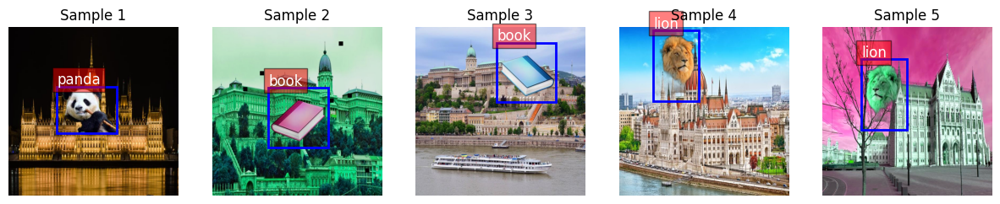

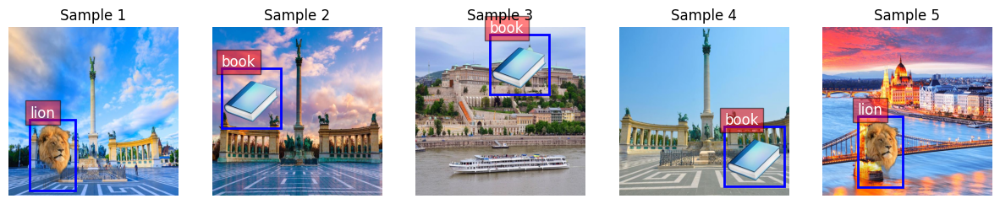

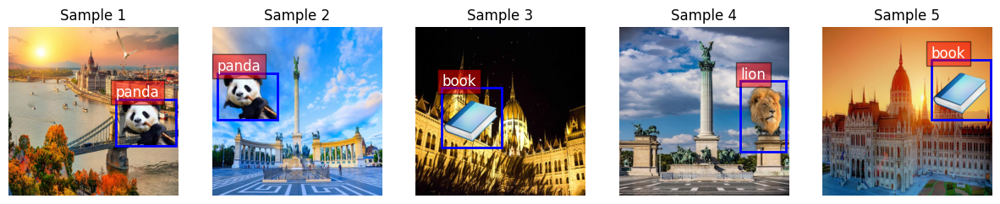

In [15]:
import matplotlib.patches as patches

# Define your object classes
object_classes = {
    "panda": 0,
    "lion": 1,
    "book": 2
}

# Show some visualizations of the created dataset
def visualize_dataset(dataset, num_samples=5):
    # Set the figure size
    plt.figure(figsize=(15, 10))
    
    for i in range(num_samples):
        # Get a sample from the dataset
        image, categories, bboxes = dataset[i]
       
        # Convert the image tensor back to a NumPy array for visualization
        image_np = image.permute(1, 2, 0).numpy()  # Convert from (C, H, W) to (H, W, C)
        
        # Create a subplot
        ax = plt.subplot(1, num_samples, i + 1)
        ax.imshow(image_np)
        
        # Add the bounding boxes and class names
        for bbox, category in zip(bboxes, categories):
            x1, y1, x2, y2 = bbox
            width = x2 - x1
            height = y2 - y1

            # Create a rectangle patch for the bounding box
            rect = patches.Rectangle((x1, y1), width, height, linewidth=2, edgecolor='b', facecolor='none')
            ax.add_patch(rect)

            # Get the class name
            class_name = [key for key, value in object_classes.items() if value == category]
            if class_name:
                # Display the class name near the top-left of the bounding box
                ax.text(x1, y1 - 10, class_name[0], color='white', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

        # Set the title with the sample number
        ax.set_title(f'Sample {i + 1}')
        ax.axis('off')  # Hide the axes for better visualization

    plt.show()


visualize_dataset(train_dataset)
visualize_dataset(test_dataset)
visualize_dataset(val_dataset)


### 2. MODELS

In this assignment, you are tasked with building your own custom object detection model and comparing its performance against an existing object detection model.


### 2.1. Custom Object Detection model

### Create a Convolutional Neural Network (CNN) Architecture

Design a CNN-based architecture that includes a **backbone for feature extraction** and two output branches:

- One for **class probabilities** (with output size equal to the number of object classes, e.g., 3).
- Another for **bounding box regression** (with size 4 for the box coordinates: x, y, w, h, or in your chosen format).

This is the core evaluation of the assignment. Experiment with different layers, hyperparameters, and regularization techniques to optimize the model's performance.


In [16]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [5]:
import torch
import torch.nn as nn

class CNNObjectDetectionModel(nn.Module):
    def __init__(self, num_classes=3, alpha=0.7):
        super(CNNObjectDetectionModel, self).__init__()
        self.alpha = alpha  # Alpha is a weighting factor for loss function during training
        
        # Backbone - Expanded feature extraction layers 
        
    
        self.backbone = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),  # (640, 640) -> (640, 640) # # Convolutional layers are used here to extract features from the input image
            nn.BatchNorm2d(16),  # Batch normalization helps to stabilize and speed up training
            nn.ReLU(),   # Activation function introduces non-linearity
            nn.MaxPool2d(kernel_size=2, stride=2),                  # (640, 640) -> (320, 320) # Downsampling, reduces spatial dimension

            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),  # (320, 320) -> (320, 320) 
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),                  # (320, 320) -> (160, 160)

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),  # (160, 160) -> (160, 160)
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),                  # (160, 160) -> (80, 80)

            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1), # (80, 80) -> (80, 80)
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),                  # (80, 80) -> (40, 40)

            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),# (40, 40) -> (40, 40)
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),                  # (40, 40) -> (20, 20)

            
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1),# (20, 20) -> (20, 20)
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),                  # (20, 20) -> (10, 10)

           
            nn.Conv2d(512, 1024, kernel_size=3, stride=1, padding=1),# (10, 10) -> (10, 10)
            nn.BatchNorm2d(1024),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),                  # (10, 10) -> (5, 5)

         
            nn.Conv2d(1024, 2048, kernel_size=3, stride=1, padding=1),# (5, 5) -> (5, 5)
            nn.BatchNorm2d(2048),
            nn.ReLU()
        )
        
        # Global Average Pooling to reduce the feature size
        self.gap = nn.AdaptiveAvgPool2d((1, 1))  # (5, 5) -> (1, 1)

         # Classifier Branch - Predicts object class from the extracted features
        self.classifier = nn.Sequential(
            nn.Linear(2048, 512),  # Reduces the 2048 feature maps to 512 for classification
            nn.ReLU(),  # Non-linearity to model complex patterns
            nn.Dropout(0.3),  # Dropout to reduce overfitting, randomly deactivates 30% of neurons during training
            nn.Linear(512, 256),  # Reduction to 256-dimensional vector
            nn.ReLU(),  
            nn.Dropout(0.3),  
            nn.Linear(256, num_classes)  # Final layer outputs the number of classes (3 in this case)
        )
        
         # Bounding Box Regressor Branch - Predicts bounding box coordinates for the object
        self.bbox_regressor = nn.Sequential(
            nn.Linear(2048, 512),  # feature maps are reduced to 512 for bounding box regression
            nn.ReLU(),      # Non-linearity to model complex patterns   
            nn.Dropout(0.3),  # Dropout to reduce overfitting, randomly deactivates 30% of neurons during training
            nn.Linear(512, 256),  # Reduction to 256-dimensional vector
            nn.ReLU(),  
            nn.Dropout(0.3),  
            nn.Linear(256, 4)  # Final layer outputs 4 values representing the bounding box (x, y, width, height)
        )

    def forward(self, x):
        # Extract features using the backbone
        features = self.backbone(x)  # (batch_size, 2048, 5, 5) # Extracts high-dimensional feature maps from input images
        
        # Apply global average pooling
        features = self.gap(features)  # (batch_size, 2048, 1, 1) # Reduces spatial dimensions to 1x1 by averaging across the entire feature map
        
        # Flatten the features from (batch_size, 2048, 1, 1) to (batch_size, 2048)
        features = features.view(features.size(0), -1)
        
        # Predict class probabilities
        class_probs = self.classifier(features)
        
        # Predict bounding boxes
        bbox_preds = self.bbox_regressor(features)

        return class_probs, bbox_preds


In [20]:
from torchsummary import summary

model=CNNObjectDetectionModel(num_classes=3,alpha=0.7)
model.to('cuda' if torch.cuda.is_available() else 'cpu')

# Get the summary of the model (input size: 3 channels, 640x640 image size)
summary(model, input_size=(3, 640, 640))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 640, 640]             448
       BatchNorm2d-2         [-1, 16, 640, 640]              32
              ReLU-3         [-1, 16, 640, 640]               0
         MaxPool2d-4         [-1, 16, 320, 320]               0
            Conv2d-5         [-1, 32, 320, 320]           4,640
       BatchNorm2d-6         [-1, 32, 320, 320]              64
              ReLU-7         [-1, 32, 320, 320]               0
         MaxPool2d-8         [-1, 32, 160, 160]               0
            Conv2d-9         [-1, 64, 160, 160]          18,496
      BatchNorm2d-10         [-1, 64, 160, 160]             128
             ReLU-11         [-1, 64, 160, 160]               0
        MaxPool2d-12           [-1, 64, 80, 80]               0
           Conv2d-13          [-1, 128, 80, 80]          73,856
      BatchNorm2d-14          [-1, 128,

### 2.2. Train Your Model

Carefully choose key components like the **optimizer**, **loss function**, **number of epochs**, and **regularization techniques**. Ensure you're optimizing both **classification loss** and **bounding box regression loss**.

Monitor for signs of **overfitting** or **underfitting** by tracking how the loss evolves across epochs. The loss should consistently decrease as training progresses. Save and log these losses for visualization and further analysis.


**Example Plot**:

<a href="https://ibb.co/bzmMxJY"><img src="https://i.ibb.co/t8KTSXn/download.png" alt="download" border="0"></a>

/home/syma/.local/lib/python3.8/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
Validation Epoch 1/50: 100%|██████████| 125/125 [00:04<00:00, 27.57it/s]


Epoch [1/50], Train Class Loss: 1.1411, Train Bbox Loss: 0.0812, Val Class Loss: 1.0482, Val Bbox Loss: 0.0211


Validation Epoch 2/50: 100%|██████████| 125/125 [00:04<00:00, 27.32it/s]


Epoch [2/50], Train Class Loss: 1.0809, Train Bbox Loss: 0.0319, Val Class Loss: 0.9987, Val Bbox Loss: 0.0149


Validation Epoch 3/50: 100%|██████████| 125/125 [00:04<00:00, 27.30it/s]


Epoch [3/50], Train Class Loss: 1.0329, Train Bbox Loss: 0.0254, Val Class Loss: 0.9222, Val Bbox Loss: 0.0111


Validation Epoch 4/50: 100%|██████████| 125/125 [00:04<00:00, 27.56it/s]


Epoch [4/50], Train Class Loss: 0.9675, Train Bbox Loss: 0.0228, Val Class Loss: 0.7789, Val Bbox Loss: 0.0100


Validation Epoch 5/50: 100%|██████████| 125/125 [00:04<00:00, 26.02it/s]


Epoch [5/50], Train Class Loss: 0.8755, Train Bbox Loss: 0.0194, Val Class Loss: 0.5882, Val Bbox Loss: 0.0078


Validation Epoch 6/50: 100%|██████████| 125/125 [00:04<00:00, 27.11it/s]


Epoch [6/50], Train Class Loss: 0.7202, Train Bbox Loss: 0.0178, Val Class Loss: 0.3582, Val Bbox Loss: 0.0058


Validation Epoch 7/50: 100%|██████████| 125/125 [00:04<00:00, 26.81it/s]


Epoch [7/50], Train Class Loss: 0.5532, Train Bbox Loss: 0.0168, Val Class Loss: 0.1906, Val Bbox Loss: 0.0054


Validation Epoch 8/50: 100%|██████████| 125/125 [00:04<00:00, 26.99it/s]


Epoch [8/50], Train Class Loss: 0.4197, Train Bbox Loss: 0.0154, Val Class Loss: 0.0601, Val Bbox Loss: 0.0051


Validation Epoch 9/50: 100%|██████████| 125/125 [00:04<00:00, 26.83it/s]


Epoch [9/50], Train Class Loss: 0.2980, Train Bbox Loss: 0.0143, Val Class Loss: 0.0636, Val Bbox Loss: 0.0041


Validation Epoch 10/50: 100%|██████████| 125/125 [00:04<00:00, 26.59it/s]


Epoch [10/50], Train Class Loss: 0.2232, Train Bbox Loss: 0.0132, Val Class Loss: 0.0202, Val Bbox Loss: 0.0040


Validation Epoch 11/50: 100%|██████████| 125/125 [00:04<00:00, 31.02it/s]


Epoch [11/50], Train Class Loss: 0.1852, Train Bbox Loss: 0.0125, Val Class Loss: 0.0202, Val Bbox Loss: 0.0038


Validation Epoch 12/50: 100%|██████████| 125/125 [00:04<00:00, 30.63it/s]


Epoch [12/50], Train Class Loss: 0.1499, Train Bbox Loss: 0.0120, Val Class Loss: 0.0256, Val Bbox Loss: 0.0030


Validation Epoch 13/50: 100%|██████████| 125/125 [00:04<00:00, 30.80it/s]


Epoch [13/50], Train Class Loss: 0.1208, Train Bbox Loss: 0.0112, Val Class Loss: 0.0088, Val Bbox Loss: 0.0030


Validation Epoch 14/50: 100%|██████████| 125/125 [00:04<00:00, 30.83it/s]


Epoch [14/50], Train Class Loss: 0.1002, Train Bbox Loss: 0.0106, Val Class Loss: 0.0046, Val Bbox Loss: 0.0022


Validation Epoch 15/50: 100%|██████████| 125/125 [00:04<00:00, 30.84it/s]


Epoch [15/50], Train Class Loss: 0.0915, Train Bbox Loss: 0.0097, Val Class Loss: 0.0040, Val Bbox Loss: 0.0030


Validation Epoch 16/50: 100%|██████████| 125/125 [00:04<00:00, 30.80it/s]


Epoch [16/50], Train Class Loss: 0.0832, Train Bbox Loss: 0.0096, Val Class Loss: 0.0056, Val Bbox Loss: 0.0024


Validation Epoch 17/50: 100%|██████████| 125/125 [00:04<00:00, 31.05it/s]


Epoch [17/50], Train Class Loss: 0.0781, Train Bbox Loss: 0.0088, Val Class Loss: 0.0037, Val Bbox Loss: 0.0017


Validation Epoch 18/50: 100%|██████████| 125/125 [00:04<00:00, 31.06it/s]


Epoch [18/50], Train Class Loss: 0.0741, Train Bbox Loss: 0.0083, Val Class Loss: 0.0022, Val Bbox Loss: 0.0017


Validation Epoch 19/50: 100%|██████████| 125/125 [00:04<00:00, 30.61it/s]


Epoch [19/50], Train Class Loss: 0.0636, Train Bbox Loss: 0.0082, Val Class Loss: 0.0008, Val Bbox Loss: 0.0016


Validation Epoch 20/50: 100%|██████████| 125/125 [00:04<00:00, 30.60it/s]


Epoch [20/50], Train Class Loss: 0.0738, Train Bbox Loss: 0.0076, Val Class Loss: 0.0027, Val Bbox Loss: 0.0015


Validation Epoch 21/50: 100%|██████████| 125/125 [00:04<00:00, 30.85it/s]


Epoch [21/50], Train Class Loss: 0.0699, Train Bbox Loss: 0.0074, Val Class Loss: 0.0012, Val Bbox Loss: 0.0014


Validation Epoch 22/50: 100%|██████████| 125/125 [00:04<00:00, 31.06it/s]


Epoch [22/50], Train Class Loss: 0.0516, Train Bbox Loss: 0.0071, Val Class Loss: 0.0006, Val Bbox Loss: 0.0016


Validation Epoch 23/50: 100%|██████████| 125/125 [00:05<00:00, 23.83it/s]


Epoch [23/50], Train Class Loss: 0.0416, Train Bbox Loss: 0.0067, Val Class Loss: 0.0010, Val Bbox Loss: 0.0015


Validation Epoch 24/50: 100%|██████████| 125/125 [00:04<00:00, 26.74it/s]


Epoch [24/50], Train Class Loss: 0.0363, Train Bbox Loss: 0.0064, Val Class Loss: 0.0007, Val Bbox Loss: 0.0013


Validation Epoch 25/50: 100%|██████████| 125/125 [00:04<00:00, 26.50it/s]


Epoch [25/50], Train Class Loss: 0.0451, Train Bbox Loss: 0.0063, Val Class Loss: 0.0002, Val Bbox Loss: 0.0010


Validation Epoch 26/50: 100%|██████████| 125/125 [00:04<00:00, 26.78it/s]


Epoch [26/50], Train Class Loss: 0.0384, Train Bbox Loss: 0.0061, Val Class Loss: 0.0004, Val Bbox Loss: 0.0012


Validation Epoch 27/50: 100%|██████████| 125/125 [00:04<00:00, 26.81it/s]


Epoch [27/50], Train Class Loss: 0.0328, Train Bbox Loss: 0.0059, Val Class Loss: 0.0002, Val Bbox Loss: 0.0011


Validation Epoch 28/50: 100%|██████████| 125/125 [00:04<00:00, 26.58it/s]


Epoch [28/50], Train Class Loss: 0.0376, Train Bbox Loss: 0.0057, Val Class Loss: 0.0003, Val Bbox Loss: 0.0015


Validation Epoch 29/50: 100%|██████████| 125/125 [00:04<00:00, 30.64it/s]


Epoch [29/50], Train Class Loss: 0.0320, Train Bbox Loss: 0.0056, Val Class Loss: 0.0014, Val Bbox Loss: 0.0008


Validation Epoch 30/50: 100%|██████████| 125/125 [00:04<00:00, 30.93it/s]


Epoch [30/50], Train Class Loss: 0.0259, Train Bbox Loss: 0.0052, Val Class Loss: 0.0001, Val Bbox Loss: 0.0008


Validation Epoch 31/50: 100%|██████████| 125/125 [00:04<00:00, 30.94it/s]


Epoch [31/50], Train Class Loss: 0.0306, Train Bbox Loss: 0.0050, Val Class Loss: 0.0001, Val Bbox Loss: 0.0006


Validation Epoch 32/50: 100%|██████████| 125/125 [00:04<00:00, 30.91it/s]


Epoch [32/50], Train Class Loss: 0.0265, Train Bbox Loss: 0.0049, Val Class Loss: 0.0002, Val Bbox Loss: 0.0008


Validation Epoch 33/50: 100%|██████████| 125/125 [00:04<00:00, 30.59it/s]


Epoch [33/50], Train Class Loss: 0.0242, Train Bbox Loss: 0.0049, Val Class Loss: 0.0001, Val Bbox Loss: 0.0008


Validation Epoch 34/50: 100%|██████████| 125/125 [00:04<00:00, 31.07it/s]


Epoch [34/50], Train Class Loss: 0.0202, Train Bbox Loss: 0.0049, Val Class Loss: 0.0001, Val Bbox Loss: 0.0008


Validation Epoch 35/50: 100%|██████████| 125/125 [00:04<00:00, 30.90it/s]


Epoch [35/50], Train Class Loss: 0.0199, Train Bbox Loss: 0.0048, Val Class Loss: 0.0001, Val Bbox Loss: 0.0012


Validation Epoch 36/50: 100%|██████████| 125/125 [00:04<00:00, 31.02it/s]


Early stopping at epoch 36


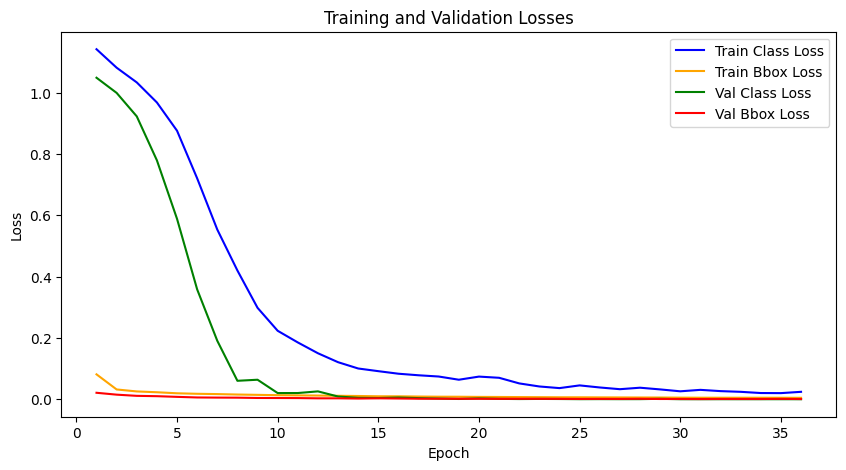

In [23]:
import torch.optim as optim
from tqdm import tqdm
from torch.cuda.amp import autocast, GradScaler
import torch.nn as nn
import torch
import copy
import matplotlib.pyplot as plt


def initialize_weights(model):
    """
    Initializes the weights of the model using Xavier initialization for Conv2d and Linear layers.
    This helps in stabilizing the training process.
    """
    for m in model.modules():
        # Check if the layer is a Conv2d or Linear layer
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
            # Xavier initialization for better weight scaling
            nn.init.xavier_uniform_(m.weight)
            if m.bias is not None:
                # If there's a bias term, initialize it to zero
                nn.init.constant_(m.bias, 0)

def normalize_bbox(bboxes, img_width, img_height):
    """
    Normalize bounding box coordinates with respect to image width and height.
    Converts bounding boxes to a range of [0, 1].
    """
    return bboxes / torch.tensor([img_width, img_height, img_width, img_height], dtype=torch.float32).to(bboxes.device)

# Training function with gradient accumulation (without checkpointing)
def train_model(model, train_loader, val_loader, optimizer, class_loss_fn, bbox_loss_fn, num_epochs=50, device='cuda', patience=5, accumulation_steps=4):
    model = model.to(device) # Move model to the device (GPU or CPU)
    scaler = GradScaler()  # Mixed precision gradient scaler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)
   
    

     # Dictionaries to store class and bounding box losses for training and validation
    train_losses = {'class': [], 'bbox': []}
    val_losses = {'class': [], 'bbox': []}
    
    # Store the best model weights
    best_model_wts = copy.deepcopy(model.state_dict())
    # Initialize best validation loss to infinity
    best_val_loss = float('inf')
    # Counter for early stopping
    early_stop_counter = 0

    for epoch in range(num_epochs):
        model.train()
        train_class_loss = 0.0
        train_bbox_loss = 0.0
        optimizer.zero_grad()  # Reset optimizer gradients
        
         # Loop over batches in the training dataset
        for i, (images, class_labels, bbox_labels) in enumerate(tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{num_epochs}")):
            # Normalize bounding boxes
            bbox_labels = normalize_bbox(bbox_labels, images.shape[3], images.shape[2])
            # Flatten bounding box labels to (batch_size, 4)
            bbox_labels = bbox_labels.view(-1, 4)
            # Flatten class labels
            class_labels = class_labels.view(-1).long()
            images, class_labels, bbox_labels = images.to(device), class_labels.to(device), bbox_labels.to(device) # Move data to device


            # Mixed precision forward pass
            with autocast():
                class_preds, bbox_preds = model(images) # Forward pass through the model
                loss_class = class_loss_fn(class_preds, class_labels)  # Classification loss
                loss_bbox = bbox_loss_fn(bbox_preds, bbox_labels) # Bounding box loss
                loss = model.alpha * loss_class + (1 - model.alpha) * (loss_bbox*100)  # Combine the two losses using alpha

            # Scale the loss for gradient accumulation
            scaler.scale(loss).backward() # Backpropagation
            
             # Update model parameters after accumulation_steps batches
            if (i + 1) % accumulation_steps == 0 or (i + 1) == len(train_loader):
                scaler.unscale_(optimizer)  # Unscale gradients before clipping
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=10)  # Gradient clipping to prevent exploding gradients

                scaler.step(optimizer)  # Perform optimization step
                scaler.update()  # Update the gradient scaler
                optimizer.zero_grad()  # Reset gradients for next batch
                
            
            # Accumulate losses
            train_class_loss += loss_class.item()
            train_bbox_loss += loss_bbox.item()
        # Average losses over all batches for the epoch
        train_losses['class'].append(train_class_loss / len(train_loader))
        train_losses['bbox'].append(train_bbox_loss / len(train_loader))

        # Validation phase
        model.eval() # Set model to evaluation mode
        val_class_loss = 0.0
        val_bbox_loss = 0.0
        # No gradients during validation
        with torch.no_grad():
            for images, class_labels, bbox_labels in tqdm(val_loader, desc=f"Validation Epoch {epoch+1}/{num_epochs}"):
                # Normalize the bounding boxes
                bbox_labels = normalize_bbox(bbox_labels, images.shape[3], images.shape[2])
                bbox_labels = bbox_labels.view(-1, 4)

                class_labels = class_labels.view(-1).long()
                images, class_labels, bbox_labels = images.to(device), class_labels.to(device), bbox_labels.to(device)
                
                # Forward pass with mixed precision
                with autocast():
                    class_preds, bbox_preds = model(images)
                    loss_class = class_loss_fn(class_preds, class_labels)
                    loss_bbox = bbox_loss_fn(bbox_preds, bbox_labels)

                val_class_loss += loss_class.item()
                val_bbox_loss += loss_bbox.item()
                
        # Average validation losses over all batches
        val_losses['class'].append(val_class_loss / len(val_loader))
        val_losses['bbox'].append(val_bbox_loss / len(val_loader))
        total_val_loss = val_losses['class'][-1] + val_losses['bbox'][-1]

        # Save the best model based on validation loss
        if total_val_loss < best_val_loss:
            best_val_loss = total_val_loss
            best_model_wts = copy.deepcopy(model.state_dict())  # Update best weights
            early_stop_counter = 0  # Reset early stopping counter
        else:
            early_stop_counter += 1  # Increment early stopping counter

        # Early stopping if validation loss doesn't improve for 'patience' epochs
        if early_stop_counter >= patience:
            print(f"Early stopping at epoch {epoch+1}")
            break

        # Print loss information for each epoch
        print(f"Epoch [{epoch+1}/{num_epochs}], Train Class Loss: {train_losses['class'][-1]:.4f}, Train Bbox Loss: {train_losses['bbox'][-1]:.4f}, Val Class Loss: {val_losses['class'][-1]:.4f}, Val Bbox Loss: {val_losses['bbox'][-1]:.4f}")

        # Adjust learning rate based on validation loss
        scheduler.step(total_val_loss)

    # Load the best model weights
    model.load_state_dict(best_model_wts)
    torch.save(model.state_dict(), 'best_model_custom.pth')  # Save the best model
    return train_losses, val_losses

# Plot the training and validation losses
def plot_losses(train_losses, val_losses):
    """Plot the training and validation losses over epochs."""
    epochs = range(1, len(train_losses['class']) + 1)
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_losses['class'], label='Train Class Loss', color='blue')
    plt.plot(epochs, train_losses['bbox'], label='Train Bbox Loss', color='orange')
    plt.plot(epochs, val_losses['class'], label='Val Class Loss', color='green')
    plt.plot(epochs, val_losses['bbox'], label='Val Bbox Loss', color='red')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Losses')
    plt.legend()
    plt.show()

# Initialize the model
model = CNNObjectDetectionModel(num_classes=3, alpha=0.7)  # Custom model with 3 classes and alpha for loss balancing
initialize_weights(model)  # Initialize model weights
class_loss_fn = nn.CrossEntropyLoss()  # Cross-entropy for classification loss
bbox_loss_fn = nn.SmoothL1Loss()  # Smooth L1 loss for bounding box regression
optimizer = optim.Adam(model.parameters(), lr=0.00001)  # Adam optimizer with a low learning rate

# Train the model and plot losses
train_losses, val_losses = train_model(model, train_loader, val_loader, optimizer, class_loss_fn, bbox_loss_fn, num_epochs=50, device='cuda' if torch.cuda.is_available() else 'cpu')
plot_losses(train_losses, val_losses)

### 2.3. Evaulate and do inference with the trained custom model

Choose **at least 3 metrics** to evaluate your object detection model. These could include:

- **Precision**: The proportion of correctly predicted positive instances (objects detected) out of all instances classified as positive.
- **Recall**: The proportion of correctly predicted positive instances out of all actual positive instances (objects present in the image).
- **F1-Score**: The harmonic mean of Precision and Recall, balancing false positives and false negatives.
- **IoU (Intersection over Union)**: Measures the overlap between the predicted bounding box and the ground truth bounding box.
- **mAP (mean Average Precision)**: This is one of the most common evaluation metrics for object detection. It averages precision at different recall thresholds across all object classes.
  
Additionally, you can assess:
- **Inference speed**: Time taken by the model to process a single image.
- **Number of parameters**: The total number of trainable parameters in the model.
- **Model size**: The disk size of the trained model.

### Show Performance Metric Visualizations

- Visualize the chosen metrics (e.g., **Precision, Recall, F1-Score, IoU, mAP**) over different epochs to demonstrate the improvement in the model’s performance.
- Plot losses (both classification loss and localization loss) to show how they decrease throughout training.

### Show Some Predictions of Your Trained Model

- Display sample images with **predicted bounding boxes** and compare them to the ground truth.
- Highlight the values of **Precision, Recall, IoU**, or other relevant metrics for each displayed prediction, giving a clear view of the model's performance.
  
You can also use **WandB (Weights and Biases)** or **TensorBoard** for more detailed logging and tracking of these metrics and visualizations.


Evaluating: 100%|██████████| 25/25 [00:01<00:00, 20.94it/s]


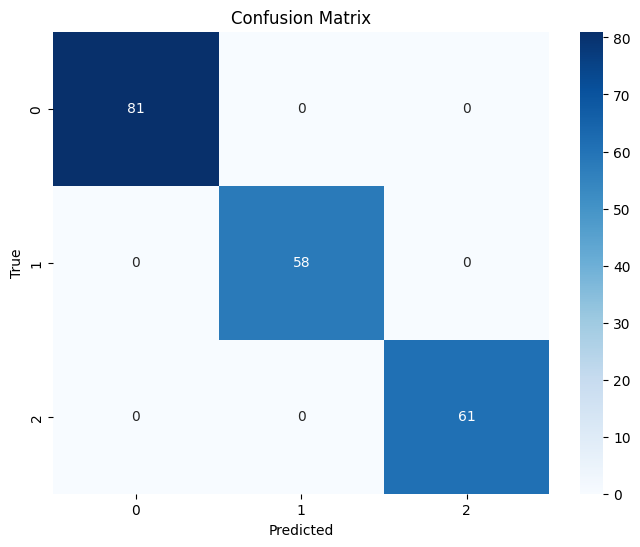

Precision: 1.0000, Recall: 1.0000, mAP: 0.9356, Mean IoU: 0.7403


In [26]:
import torch
from torchmetrics.functional import precision, recall, confusion_matrix
from torchmetrics.detection.mean_ap import MeanAveragePrecision
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm
def denormalize_bbox(bboxes, img_width, img_height):
    # Multiply normalized bounding boxes by image width and height to get pixel coordinates
    bboxes = bboxes * torch.tensor([img_width, img_height, img_width, img_height], dtype=torch.float32).to(bboxes.device)
    return bboxes


def calculate_iou(pred_boxes, true_boxes):
    iou = []  # Initialize a list to store IoU values for each box pair
    
    # Ensure the boxes have at least one dimension 
    if pred_boxes.ndim == 1:
        pred_boxes = pred_boxes.unsqueeze(0)
    if true_boxes.ndim == 1:
        true_boxes = true_boxes.unsqueeze(0)

    # Iterate through pairs of predicted and true boxes
    for pred_box, true_box in zip(pred_boxes, true_boxes):
        # Skip invalid boxes if less than 4 coordinates
        if len(pred_box) < 4 or len(true_box) < 4:
            continue

        # Calculate coordinates of the intersection rectangle
        xA = torch.max(pred_box[0], true_box[0])
        yA = torch.max(pred_box[1], true_box[1])
        xB = torch.min(pred_box[2], true_box[2])
        yB = torch.min(pred_box[3], true_box[3])

        # Compute intersection area
        interArea = torch.clamp(xB - xA + 1, min=0) * torch.clamp(yB - yA + 1, min=0)

        # Compute area of both boxes
        boxAArea = (pred_box[2] - pred_box[0] + 1) * (pred_box[3] - pred_box[1] + 1)
        boxBArea = (true_box[2] - true_box[0] + 1) * (true_box[3] - true_box[1] + 1)

        # Compute union area (union = A + B - intersection)
        unionArea = boxAArea + boxBArea - interArea

        # Calculate IoU (intersection over union)
        iou_value = interArea / unionArea if unionArea > 0 else 0.0  # Prevent division by zero
        iou.append(iou_value)  # Store IoU value for this box pair

    return torch.tensor(iou).to(pred_boxes.device)  # Return IoU as a tensor


def evaluate_test_set(model, test_loader, device, num_classes=3, iou_threshold=0.5):
    model.eval()  # Set model to evaluation mode, disables dropout and batch norm updates

    # Initialize the MeanAveragePrecision object with the provided IoU threshold
    mAP_metric = MeanAveragePrecision(iou_thresholds=[iou_threshold])

    # Lists to store predictions and ground truths for calculating metrics
    all_pred_labels = []
    all_true_labels = []
    all_ious = []  

    with torch.no_grad():  # Disable gradient calculation during evaluation
        
        # Iterate through the test set
        for images, class_labels, bbox_targets in tqdm(test_loader, desc="Evaluating"):
            images = images.to(device)  # Move images to the GPU/CPU
            class_labels = class_labels.to(device)  # Move class labels to the GPU/CPU
            bbox_targets = bbox_targets.to(device)  # Move bounding box targets to the GPU/CPU

            # Get class and bounding box predictions from the model
            class_preds, bbox_preds = model(images)

            # Apply sigmoid to class predictions (if the model uses raw logits)
            class_probs = torch.sigmoid(class_preds)

            # Get image dimensions
            img_width, img_height = images.shape[3], images.shape[2]

            # Denormalize the predicted bounding boxes
            bbox_preds = denormalize_bbox(bbox_preds, img_width, img_height)

            # Handle cases where bounding boxes are missing in either prediction or target
            if bbox_preds.size(0) == 0 or bbox_targets.size(0) == 0:
                continue

            # Append predicted and true labels to the lists
            all_pred_labels.append(class_preds.argmax(dim=1))
            all_true_labels.append(class_labels.view(-1))

            # Calculate IoU for the predicted and true bounding boxes
            iou_per_image = calculate_iou(bbox_preds, bbox_targets)
            all_ious.append(iou_per_image)  # Append IoU for each image

            # Prepare predictions and targets for mAP calculation
            preds = [{'boxes': bbox_preds, 'labels': class_preds.argmax(dim=1), 'scores': class_probs.max(dim=1)[0]}]
            targets = [{'boxes': bbox_targets, 'labels': class_labels.view(-1)}]

            # Update the mAP metric with the current batch
            mAP_metric.update(preds, targets)

    # Concatenate all predictions and true labels across batches
    all_pred_labels = torch.cat(all_pred_labels)
    all_true_labels = torch.cat(all_true_labels)

    # Calculate precision and recall
    precision_value = precision(all_pred_labels, all_true_labels, task='multiclass', num_classes=num_classes)
    recall_value = recall(all_pred_labels, all_true_labels, task='multiclass', num_classes=num_classes)

    # Compute mAP using the accumulated predictions and ground truths
    mAP_value = mAP_metric.compute()

    # Concatenate all IoUs and compute mean IoU
    all_ious = torch.cat(all_ious)
    mean_iou = all_ious.mean().item()

    # Generate a confusion matrix from the predicted and true labels
    cm = confusion_matrix(all_pred_labels, all_true_labels, task='multiclass', num_classes=num_classes)
    
    # Plot the confusion matrix using seaborn heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm.cpu().numpy(), annot=True, fmt='d', cmap='Blues')  
    plt.xlabel('Predicted') 
    plt.ylabel('True')  
    plt.title('Confusion Matrix')
    plt.show()  

    
    return precision_value.item(), recall_value.item(), mAP_value['map'].item(), mean_iou


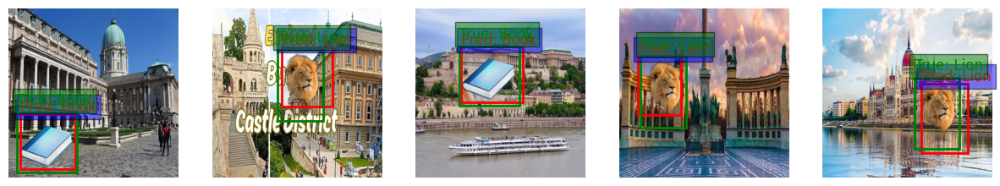

In [27]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torch

# Define your object classes
object_classes = {
    0: "Panda",
    1: "Lion",
    2: "Book"
}


def visualize_predictions(model, test_dataset, num_samples=5, device='cuda'):
    model.eval()  # Set the model to evaluation mode 
    
    # Set the figure size for the plots
    plt.figure(figsize=(15, 10))
    
    # Disable gradient computation, we only need forward pass for evaluation
    with torch.no_grad():
        for i in range(num_samples):  # Loop over the specified number of samples
            
            # Get a image, true categories, and true bounding boxes from the test dataset
            image, true_categories, true_bboxes = test_dataset[i]
            image = image.to(device).unsqueeze(0)  # Move the image to the device (GPU) and add batch dimension

            # Forward pass through the model to get predictions 
            pred_categories, pred_bboxes = model(image)

            # Get the height and width of the image for denormalizing the bounding boxes
            img_height, img_width = image.shape[2], image.shape[3]
            pred_bboxes = pred_bboxes.squeeze(0)  # Remove the batch dimension from the predicted bounding boxes
            
            # Denormalize the predicted bounding boxes back to pixel coordinates
            pred_bboxes = denormalize_bbox(pred_bboxes, img_width, img_height).cpu().numpy()  # Move to CPU and convert to numpy array for plotting
            
            # Ensure predicted bounding boxes are in the correct format (n, 4)
            if pred_bboxes.ndim == 1:
                pred_bboxes = pred_bboxes.reshape(-1, 4)

            # Get the predicted categories (apply argmax to get the class with the highest score)
            pred_categories = torch.argmax(pred_categories, dim=1).cpu().numpy()

            # Convert the image back to a NumPy array for visualization (change format from (C, H, W) to (H, W, C))
            image_np = image.squeeze(0).permute(1, 2, 0).cpu().numpy()

            # Create a subplot for each image
            ax = plt.subplot(1, num_samples, i + 1)
            ax.imshow(image_np)  # Display the image

            # Add predicted bounding boxes in red
            for bbox, category in zip(pred_bboxes, pred_categories):  # Loop through each predicted bounding box and category
                x1, y1, x2, y2 = bbox  # Extract bounding box coordinates
                
                
                # Ensure width and height are positive before drawing the rectangle
                if (x2 - x1) > 0 and (y2 - y1) > 0:  
                    # Create a red rectangle for the predicted bounding box
                    rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)  # Add the rectangle to the plot
                    # Add text for the predicted class label
                    ax.text(x1, y1 - 10, f'Pred: {object_classes.get(int(category))}', color='red', fontsize=12, bbox=dict(facecolor='blue', alpha=0.5))
                
            # Add true bounding boxes in green
            for bbox, category in zip(true_bboxes, true_categories):  # Loop through each true bounding box and category
                x1, y1, x2, y2 = bbox  # Extract bounding box coordinates
                # Create a green rectangle for the true bounding box
                rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='g', facecolor='none')
                ax.add_patch(rect)  # Add the rectangle to the plot
                # Add text for the true class label
                ax.text(x1, y1 - 30, f'True: {object_classes.get(int(category.item()))}', color='green', fontsize=12, bbox=dict(facecolor='green', alpha=0.5))

            ax.axis('off')  # Hide the axes for better visualization

    plt.show()  


visualize_predictions(model, test_dataset, num_samples=5, device='cuda')


### 2.4. Load an Existing Object Detection Model

We recommend using the latest **YOLO** version, but you are free to choose any other **PyTorch-based** object detection model.


### 2.5. Fine-tune the existing object detection model
If you choose to use **YOLO**, training the model can be done easily by providing a `data.yaml` file (which follows a specific format, check the official GitHub repository for details) and running the training script.

For example, you can run YOLO from the command line with:

```bash
!yolo task=detect mode=train data=datasets/data.yaml model=yolov8n.yaml epochs=200 imgsz=640
```

Make sure to show the losses and metrics visualizations. By default, YOLO should **verbose** those.

In [1]:
!yolo task=detect mode=train data=dataset/data.yaml model=yolov8n.yaml epochs=50 imgsz=640

Ultralytics 8.3.19 🚀 Python-3.10.0 torch-2.5.0+cu124 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 3902MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf

### 2.6 Evaluate the existing object detection model
**Compare the performance** of your custom model and the YOLO model, ensuring both are evaluated on the **same subset of images** using the **same metrics** chosen in **Step 2.3** (e.g., Precision, Recall, F1-Score, IoU, mAP).


In [1]:
# ADD YOUR CODE HERE
from ultralytics import YOLO
# Load the trained model
model = YOLO('runs/detect/train/weights/best.pt')  # Path to your trained model

# Perform validation 
metrics = model.val()



Ultralytics 8.3.19 🚀 Python-3.10.0 torch-2.5.0+cu124 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 3902MiB)
YOLOv8n summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/val/labels... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:00<00:00, 2601.26it/s]

val: New cache created: /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/val/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 63/63 [00:08<00:00,  7.44it/s]


                   all       1000       1000          1          1      0.995      0.995
                 panda        347        347          1          1      0.995      0.995
                  lion        320        320          1          1      0.995      0.995
                  book        333        333          1          1      0.995      0.995
Speed: 0.4ms preprocess, 5.6ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/val2


In [1]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import os
import random
import cv2

# Load trained model
model = YOLO('runs/detect/train/weights/best.pt')

# Path to test images
image_dir = '/home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images'
image_paths = [os.path.join(image_dir, img) for img in os.listdir(image_dir) if img.endswith(('.jpg', '.png', '.jpeg'))]

# Path to save the predictions
save_dir = 'runs/detect/test_results'
os.makedirs(save_dir, exist_ok=True)

# Select 20 random images from the test dataset
num_images = min(20, len(image_paths))  
random_image_paths = random.sample(image_paths, num_images)



for i, img_path in enumerate(random_image_paths):
    # Run inference on the image with  proper image size
    results = model(img_path, imgsz=640)

    # Get the first result from the list 
    result = results[0]
    
    # Use result.plot() to get the annotated image with predictions
    annotated_img = result.plot()  #PLot BGR Format
    # Check if the plot returns a valid image
    if annotated_img is not None:  
        # Convert BGR to RGB for proper color display in Matplotlib
        annotated_img_rgb = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)
        
        # Save the annotated image to disk
        save_path = os.path.join(save_dir, f"prediction_{i+1}.jpg")
        cv2.imwrite(save_path, annotated_img)
    else:
        print(f"Error: No annotated image was returned for {img_path}")




image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00024.jpg: 640x640 1 book, 7.0ms
Speed: 2.7ms preprocess, 7.0ms inference, 394.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00160.jpg: 640x640 1 lion, 6.6ms
Speed: 1.5ms preprocess, 6.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00041.jpg: 640x640 1 book, 6.5ms
Speed: 1.6ms preprocess, 6.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00111.jpg: 640x640 1 panda, 6.3ms
Speed: 1.2ms preprocess, 6.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00107.jpg: 640x640 1 lion, 6.5ms
Speed: 1.4ms preprocess, 6.5ms inference, 1.4ms postproces

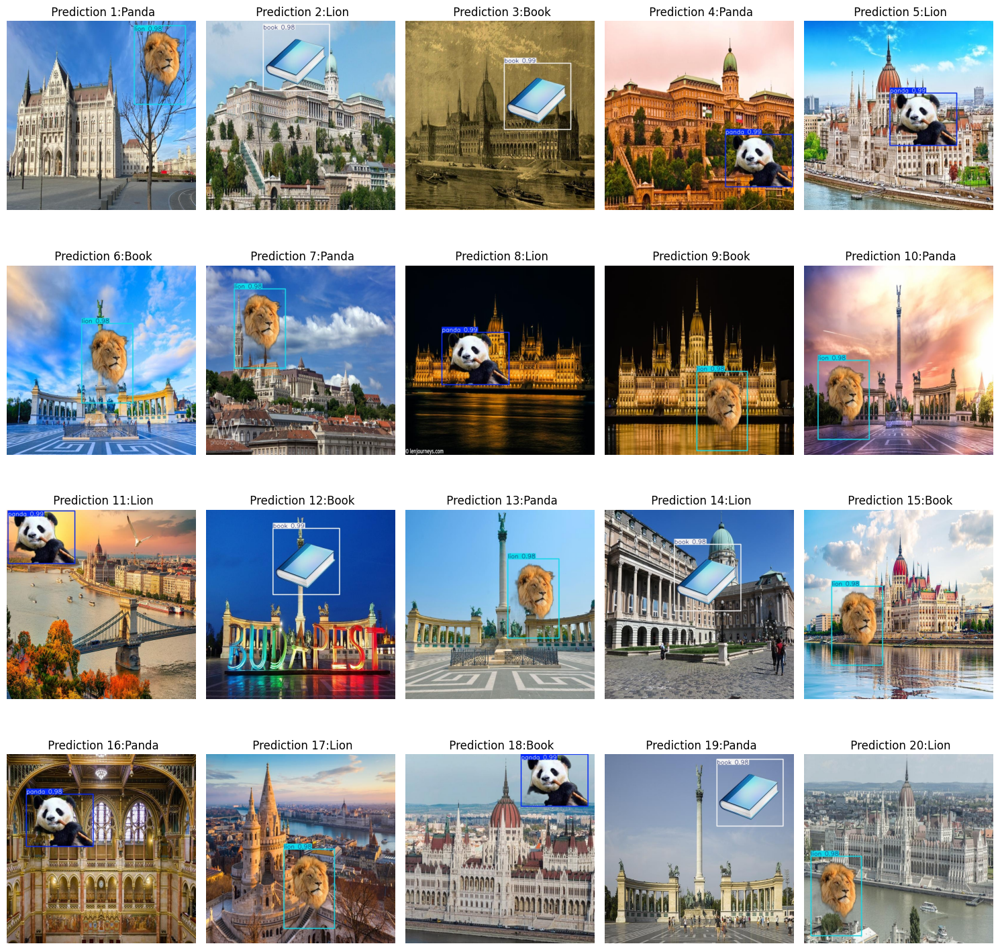

In [2]:
import os
import cv2
import matplotlib.pyplot as plt

# Path to the saved test images folder 
save_dir = 'runs/detect/test_results'

# Define object classes
object_classes = {0: "Panda", 1: "Lion", 2: "Book"}

# List all image files in the folder
saved_image_paths = [os.path.join(save_dir, img) for img in os.listdir(save_dir) if img.endswith(('.jpg', '.png', '.jpeg'))]

# Check if images are found
if not saved_image_paths:
    print("No images found in the directory.")
else:
    # Limit the number of images to 20 for display
    num_images = min(len(saved_image_paths), 20)
    
    # Set up Matplotlib to display the images
    plt.figure(figsize=(15, 15))

    # Loop through and display each saved image
    for i, img_path in enumerate(saved_image_paths[:num_images]):  # Limit to 20 images
        img = cv2.imread(img_path)
        if img is None:
            print(f"Error loading image: {img_path}")
            continue  # Skip if the image could not be loaded

        # Convert BGR to RGB for Matplotlib
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Map class index to class name using the dictionary
        class_index = i % len(object_classes)  
        class_name = object_classes.get(class_index)  

        # Create a subplot for each image
        plt.subplot(4, 5, i + 1)  
        plt.imshow(img_rgb)  # Show the image in RGB
        plt.axis('off')  # Hide axis labels
        plt.title(f' Prediction {i+1}:{class_name}')

    # Show the images
    plt.tight_layout()
    plt.show()


# 3. COMPARISON
**Compare the performance** of your custom model and the YOLO model, ensuring both are evaluated on the **same subset of images** for a fair comparison. Key metrics to include:

- **Precision**
- **Recall**
- **F1-Score**
- **IoU (Intersection over Union)**
- **mAP (mean Average Precision)**


| Metric                 | Custom CNN Model | YOLO Model |
|------------------------|------------------|------------|
| **Precision**           | 1.0000           | 1.0000     |
| **Recall**              | 1.0000           | 1.0000     |
| **mAP (Mean Average Precision)** | 0.9356 | 0.995  |



### Visualize Predictions

- Show predictions from both models on the same images.
- Include bounding boxes, class labels, and relevant metrics like IoU or Precision.

### Explain Differences

- Discuss why one model may perform better than the other, considering architecture, dataset complexity, or fine-tuning.

### 1. Model Architecture

- **YOLO** (You Only Look Once)  is designed specifically for object detection. Its architecture is optimized for speed and accuracy. It divides the input image into a grid and predicts bounding boxes and class probabilities for each cell in a single pass, which makes it very fast.  It uses  deep neural network with many layers of convolutional blocks, which helps it capture fine details and high-level features in the images. It integrates feature pyramids, which allow the model to detect objects at multiple scales, making it more robust in handling complex images with varying object sizes.


- **Custom CNN Model**  is a custom convolutional neural network architecture designed for object detection. It has fewer layers or lack specialized object detection features like YOLO’s grid-based output. While it can perform classification and bounding box regression, it might not be as efficient at handling complex object detection tasks.The custom model does not have the capacity to capture the same level of detail as YOLO, especially if it lacks advanced components like residual blocks or attention mechanisms. This could lead to poorer performance in terms of both accuracy and IoU. Unless transfer learning is used, the custom model starts training from scratch, meaning it does not have the benefit of pre-learned knowledge that helps generalize better on smaller datasets.

### 2. Dataset Complexity
- **YOLO**  models are often pre-trained on large, diverse datasets such as COCO, which provides them with a significant advantage when it comes to generalizing across different objects, lighting conditions, and environments. Pre-trained YOLO models are equipped to detect a wide range of object sizes, shapes, and orientations due to their extensive training on diverse datasets. This makes them more robust in detecting objects across a variety of scenarios.

- **Custom CNN Model**, on the other hand, does not have enough training data like Yolo to handle the complexities of real-world object detection.  The custom model struggle with variability in object size, orientation, or occlusion unless it has been fine-tuned with a diverse set of augmentations. Without proper data augmentation or exposure to varied training data, the model performed  poorly in detecting objects that deviate from the typical patterns it has seen.

### 3. Fine-Tuning and Training Technique
- **YOLO** models come with default hyperparameters that are already tuned for optimal performance. Fine-tuning YOLO on specific tasks using transfer learning is much more efficient. By starting with pre-trained weights, YOLO can achieve high performance with fewer training epochs compared to training a model from scratch.


- **Custom CNN Model** The custom model requires careful tuning of hyperparameters like learning rate, batch size, and optimizer settings. Without extensive experimentation, it is easy for the custom model to underperform due to poor hyperparameter choices. the custom model is trained from scratch, it requires more data and time to reach competitive performance. 

In conclusion, YOLO may outperform the custom model due to its advanced architecture, pre-training, and optimization, but with careful tuning and architectural improvements, the custom model can be enhanced to deliver more competitive performance.

### Improve Custom Model

- Suggest improvements such as better data augmentation, model architecture adjustments, hyperparameter tuning, or more training data.
- Explore **Transfer Learning**, **learning rate scheduling**, or new optimizers for better performance.
#### 1. Model Architecture Adjustments
My current architecture includes eight convolutional layers with batch normalization and ReLU activations. While this setup is effective, here are some ideas to further improve the model's capacity:

* Depthwise Separable Convolutions: Replace standard convolutions with depthwise separable convolutions. This reduces the number of parameters and improves efficiency while maintaining performance, especially for lightweight models.

* Residual Connections (ResNet-style blocks): Adding skip connections  allows the model to preserve gradient flow in deeper layers and improves training stability. This can help the model extract deeper features without vanishing gradients.

* Feature Pyramid Networks (FPN): Integrating FPNs helps in detecting objects at multiple scales. FPNs combine low-resolution, semantically rich features with high-resolution, spatially detailed features, improving detection performance for small objects.

* Attention Mechanisms: Incorporating attention modules (like SE blocks or CBAM) can allow the model to focus on more important regions of the image, improving accuracy in challenging scenarios where objects are small or occluded.

These architectural enhancements enable the model to learn more discriminative and robust feature representations, leading to better detection accuracy.

#### 2. Better Data Augmentation
While I am  already using augmentations like horizontal flipping, random rotation, color jitter, and dropout, there are additional techniques that can improve the model’s robustness, especially on complex datasets:
Advanced Augmentation Techniques:
* CutMix / MixUp: These techniques create new training samples by blending multiple images and their labels. This can make the model more robust to object occlusions and help in generalization.
* Mosaic Augmentation: Combine four images into one during training. This approach is used in YOLOv5/YOLOv8 and helps models generalize to multiple object scales and complex scenes.
* Random Erasing: Randomly removes part of an image during training, forcing the model to learn more robust feature representations.
* More Color Transformations: Experiment with contrast, brightness, hue, and saturation variations to ensure the model performs well under varying lighting conditions.

Enhanced augmentations allow the model to see more variations in the data, which improves its ability to generalize to unseen samples.

#### 3. Transfer Learning

While my current custom model starts training from scratch, using  Transfer Learning can significantly improve performance, especially on smaller datasets:

* Pre-trained Backbone: Use a pre-trained model (such as ResNet or EfficientNet) as the backbone of my custom model. Transfer learning allows the model to start from a position of learned feature extraction rather than from scratch.

* Fine-tuning: After replacing model's backbone with a pre-trained one, fine-tune the layers on  specific dataset. Start by freezing the lower layers and fine-tuning only the higher layers that are more task-specific.



#### 4. New Loss Functions

* Focal Loss: Replace the CrossEntropy Loss for classification with Focal Loss to handle class imbalance and hard-to-classify examples more effectively. Focal loss adds a modulating term to the cross-entropy loss to focus learning on hard misclassified examples.

* IoU Loss: Incorporate IoU loss (Intersection over Union loss) for bounding box regression. This loss directly optimizes the overlap between predicted and ground truth boxes, improving the quality of predicted boxes compared to traditional L1 or Smooth L1 loss.

Custom loss functions improve the model's learning on challenging examples (like small or overlapping objects) and result in more accurate bounding box predictions.


#### 5. Hyperparameter Tuning
Currently, I am using an Adam optimizer with a learning rate of 0.00001, gradient accumulation, and a learning rate scheduler that reduces the learning rate on plateau. While these settings are solid, here are some potential improvements:

* Learning Rate Scheduling:

* * Cosine Annealing: A cosine annealing learning rate schedule gradually decreases the learning rate following a cosine curve. This can help the model converge smoothly during later epochs.

* * Cyclic Learning Rate (CLR): CLR alternates between a lower and upper learning rate bound during training, potentially escaping local minima and improving generalization.
Optimizers:

* * SGD with Momentum: While Adam is effective for faster convergence, switching to SGD with momentum and weight decay can help the model generalize better, especially on smaller datasets. 

* * AdamW: This variant of Adam decouples weight decay from the gradient updates, making it more effective for large-scale training while still preventing overfitting.

* Batch Size:
If GPU memory permits, increasing the batch size can lead to better gradient estimates and improve generalization.

Optimizing hyperparameters can lead to faster convergence and better generalization, ensuring the model learns effectively without overfitting or underfitting.

#### 6. Training Data
My dataset currently contains 5000 training images, 1000 validation images, and 200 test images, which is fairly balanced. However, additional strategies can help improve the model’s performance:
* Synthetic Data Generation: Continue generating synthetic datasets, but increase the variety of objects and backgrounds. Introduce additional occlusions, shadows, and more complex scenes to make the model more robust.

* Larger Dataset: Increase the number of training samples by collecting more real-world data that are similar to my objects . More data typically leads to better model performance.

More diverse and balanced training data provides the model with a greater variety of learning examples, which leads to improved generalization and robustness.

In [6]:
# ADD YOUR CODE HERE
# Define custom model architecture 
custom_cnn_model = CNNObjectDetectionModel(num_classes=3, alpha=0.7)

# Load the saved state_dict
custom_cnn_model.load_state_dict(torch.load('/home/syma/Documents/ELTE/DND/Final_Assignment/best_model_custom.pth'))

# Set the model to evaluation mode
custom_cnn_model.eval()
custom_cnn_model.to('cuda' if torch.cuda.is_available() else 'cpu')




CNNObjectDetectionModel(
  (backbone): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_

In [7]:

#Define Yolo model
yolo_model=YOLO('runs/detect/train/weights/best.pt')

In [11]:
import cv2
import torch

In [10]:
!mkdir compare_results

In [12]:
import matplotlib.patches as patches
import matplotlib.pyplot as plt
import cv2
import torch
import os

# Path to test images and save directories
image_dir = '/home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images'
ground_truth_dir = '/home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/labels'  # Ground truth labels

compare_results_dir = '/home/syma/Documents/ELTE/DND/Final_Assignment/compare_results'
os.makedirs(compare_results_dir, exist_ok=True)  # Create directory for comparison results

# Set the device (CUDA if available, otherwise CPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define object classes
object_classes = {0: "Panda", 1: "Lion", 2: "Book"}


def denormalize_bboxes(bboxes, img_width, img_height):
    """Convert normalized bounding box coordinates (0-1) to pixel coordinates."""
    denormalized_bboxes = bboxes.clone()  # Clone the input tensor to avoid modifying the original tensor
    denormalized_bboxes[:, 0] *= img_width  # Convert x1 from normalized to pixel coordinates
    denormalized_bboxes[:, 1] *= img_height # Convert y1 from normalized to pixel coordinates
    denormalized_bboxes[:, 2] *= img_width  # Convert x2 from normalized to pixel coordinates
    denormalized_bboxes[:, 3] *= img_height # Convert y2 from normalized to pixel coordinates
    return denormalized_bboxes


def visualize_comparison(image_path, custom_preds, yolo_results, ground_truth_classes, ground_truth_bboxes, save_path):
    img = cv2.imread(image_path)  # Read the input image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert the image from BGR to RGB for plotting
    img_height, img_width = img.shape[:2]  # Get image dimensions

    fig, ax = plt.subplots(1, figsize=(10, 10))  # Create a figure for plotting
    ax.imshow(img_rgb)  # Display the image

    # Add ground truth bounding boxes in green
    for bbox, class_id in zip(ground_truth_bboxes, ground_truth_classes):
        x1, y1, x2, y2 = bbox  # Coordinates of the bounding box
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=6, edgecolor='green', facecolor='none')  # Draw a rectangle
        ax.add_patch(rect)  # Add the rectangle to the plot
        ax.text(x1, y1 + 30, f'True: {object_classes[int(class_id)]}', color='green', fontsize=20)  # Label the bounding box with the class name
       
    # Add custom model predictions in blue
    for bbox, class_id in zip(custom_preds['bboxes'], custom_preds['classes']):
        x1, y1, x2, y2 = bbox.detach().cpu().numpy()  # Get the predicted bounding box coordinates (detach from the graph and convert to numpy)
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=4, edgecolor='blue', facecolor='none')  # Draw a rectangle
        ax.add_patch(rect)  # Add the rectangle to the plot
        ax.text(x1, y1 - 10, f'Custom: {object_classes[int(class_id)]}', color='blue', fontsize=20)  # Label the bounding box with the class name
       
    # Add YOLO model predictions in red
    for yolo_result in yolo_results:
        yolo_boxes = yolo_result.boxes.xyxy.cpu().numpy()  # Get YOLO predicted bounding boxes
        yolo_classes = yolo_result.boxes.cls.cpu().numpy()  # Get YOLO predicted class IDs
        
        for bbox, class_id in zip(yolo_boxes, yolo_classes):
            x1, y1, x2, y2 = bbox  # Bounding box coordinates
            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=4, edgecolor='red', facecolor='none')  # Draw a rectangle
            ax.add_patch(rect)  # Add the rectangle to the plot
            ax.text(x1, y1-50, f'YOLO: {object_classes[int(class_id)]}', color='red', fontsize=20)  # Label the bounding box with the class name
       
    ax.axis('off') 

    # Save the comparison images
    plt.savefig(save_path)  # Save the figure to a file
    plt.close()  # Close the figure to free memory


def load_yolo_labels(label_path, img_width, img_height):
    """Load ground truth labels in YOLO format and convert to (x1, y1, x2, y2) pixel coordinates."""
    bboxes = []  # List to store bounding boxes
    class_ids = []  # List to store class IDs
    
    with open(label_path, 'r') as file:  # Open the label file
        for line in file.readlines():
            class_id, x_center, y_center, width, height = map(float, line.strip().split())  # Read class and bounding box coordinates
            x1 = (x_center - width / 2) * img_width  # Convert center x to top-left x
            y1 = (y_center - height / 2) * img_height  # Convert center y to top-left y
            x2 = (x_center + width / 2) * img_width  # Convert width to bottom-right x
            y2 = (y_center + height / 2) * img_height  # Convert height to bottom-right y
            bboxes.append([x1, y1, x2, y2])  # Add bounding box to the list
            class_ids.append(int(class_id))  # Add class ID to the list

    return torch.tensor(bboxes), torch.tensor(class_ids)  # Return bounding boxes and class IDs as tensors

# Loop through the test images and compare predictions
for img_name in os.listdir(image_dir):
    image_path = os.path.join(image_dir, img_name)  # Get full image path

    if img_name.endswith(('.jpg', '.jpeg', '.png')):  # Check if the file is an image
        print(f"Processing image: {image_path}")

        # Perform inference with custom model
        image = cv2.imread(image_path)  # Load the image
        image_tensor = torch.tensor(image).permute(2, 0, 1).unsqueeze(0).float().to(device) / 255.0  # Convert image to tensor and move to device
        
        custom_class_preds, custom_bbox_preds = custom_cnn_model(image_tensor)  # Get predictions from custom cnn model
        custom_bbox_preds = denormalize_bboxes(custom_bbox_preds, img_width=image.shape[1], img_height=image.shape[0])  # Denormalize bounding boxes
        custom_preds = {'classes': torch.argmax(custom_class_preds, dim=1), 'bboxes': custom_bbox_preds}  # Prepare custom predictions dictionary

        # Perform inference with YOLO model
        yolo_results = yolo_model(image_path)  # Get predictions from YOLO model

        # Load ground truth labels 
        label_name = img_name.replace('.jpg', '.txt').replace('.jpeg', '.txt').replace('.png', '.txt')  # Get corresponding label file name
        label_path = os.path.join(ground_truth_dir, label_name)  # Get full label file path

        if os.path.exists(label_path):  # Check if the label file exists
            ground_truth_bboxes, ground_truth_classes = load_yolo_labels(label_path, img_width=image.shape[1], img_height=image.shape[0])  # Load ground truth labels

            # Save the comparison results
            save_path = os.path.join(compare_results_dir, f"{os.path.splitext(img_name)[0]}_comparison.png")  # Set the path to save the comparison image
            visualize_comparison(image_path, custom_preds, yolo_results, ground_truth_classes, ground_truth_bboxes, save_path)  # Visualize and save the comparison
            print(f"Comparison saved for {img_name} in {compare_results_dir}")
        else:
            print(f"No ground truth label found for {img_name}")

Processing image: /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00091.jpg

image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00091.jpg: 640x640 1 book, 5.5ms
Speed: 2.6ms preprocess, 5.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Comparison saved for 00091.jpg in /home/syma/Documents/ELTE/DND/Final_Assignment/compare_results
Processing image: /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00069.jpg

image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00069.jpg: 640x640 1 panda, 5.2ms
Speed: 0.9ms preprocess, 5.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Comparison saved for 00069.jpg in /home/syma/Documents/ELTE/DND/Final_Assignment/compare_results
Processing image: /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00041.jpg

image 1/1 /home/syma/Documents/ELTE/DND/Final_Assignment/dataset/test/images/00041.jpg: 640x640 1 book, 6

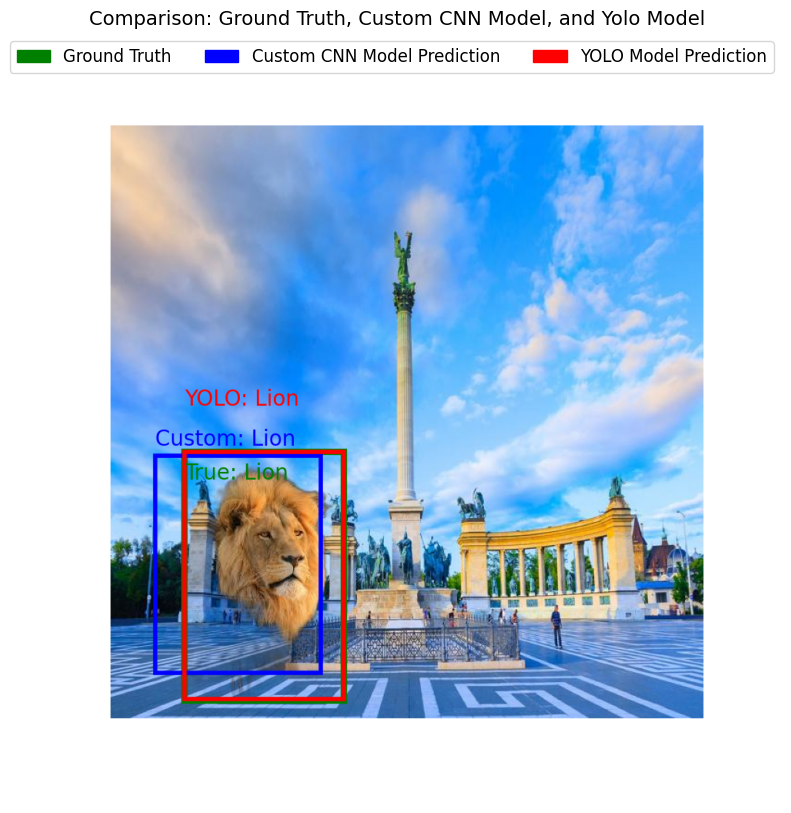

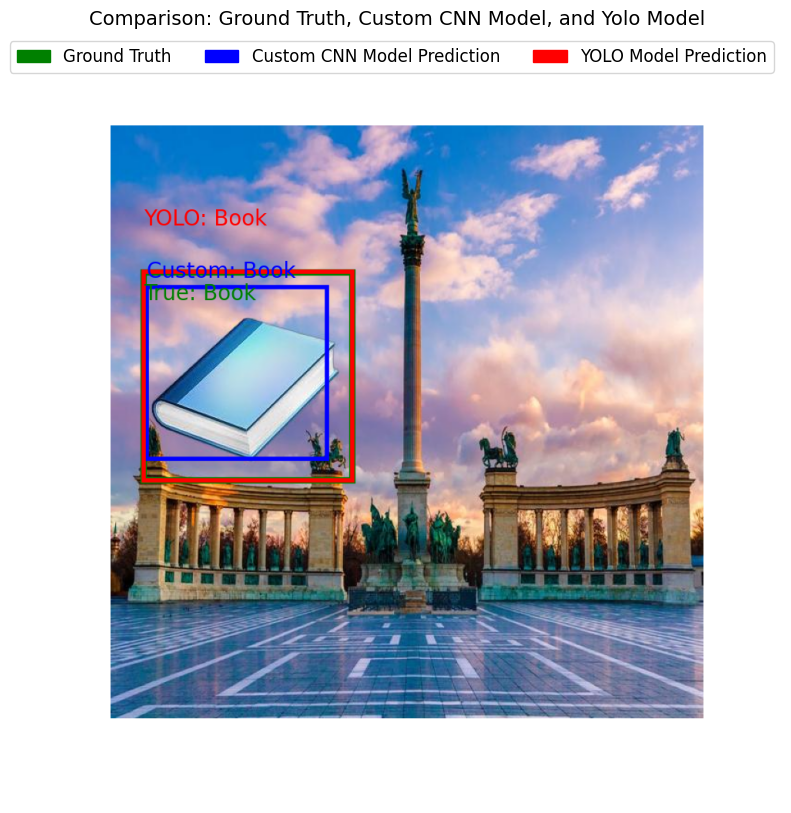

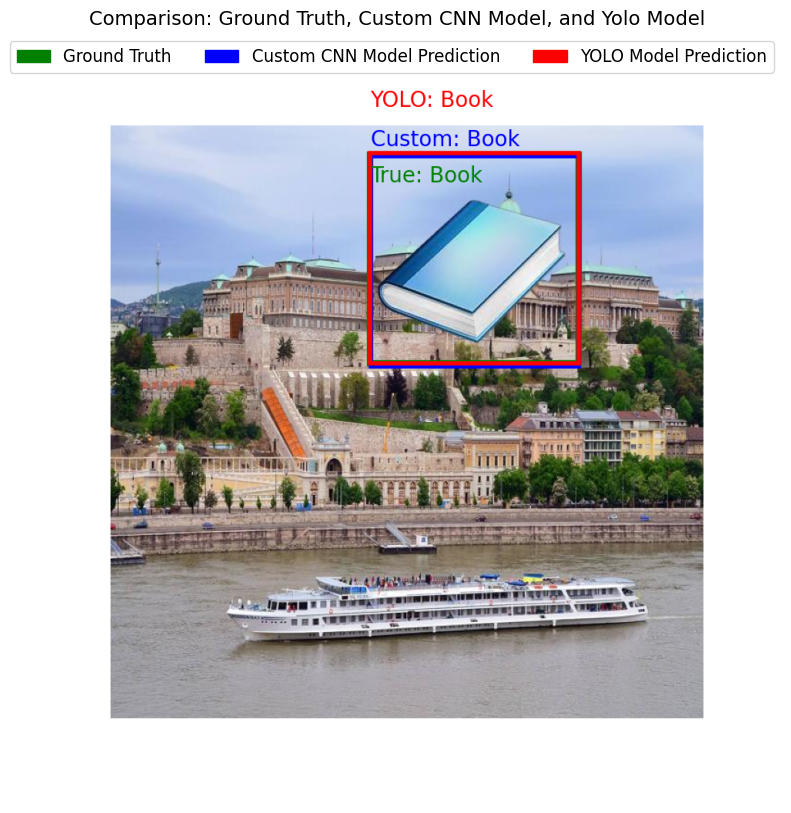

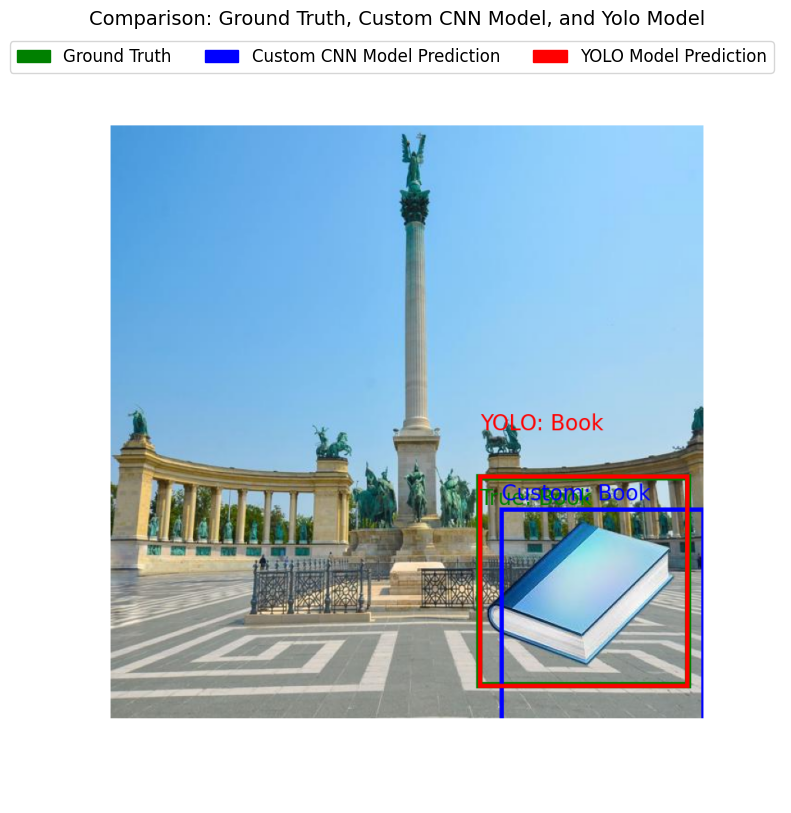

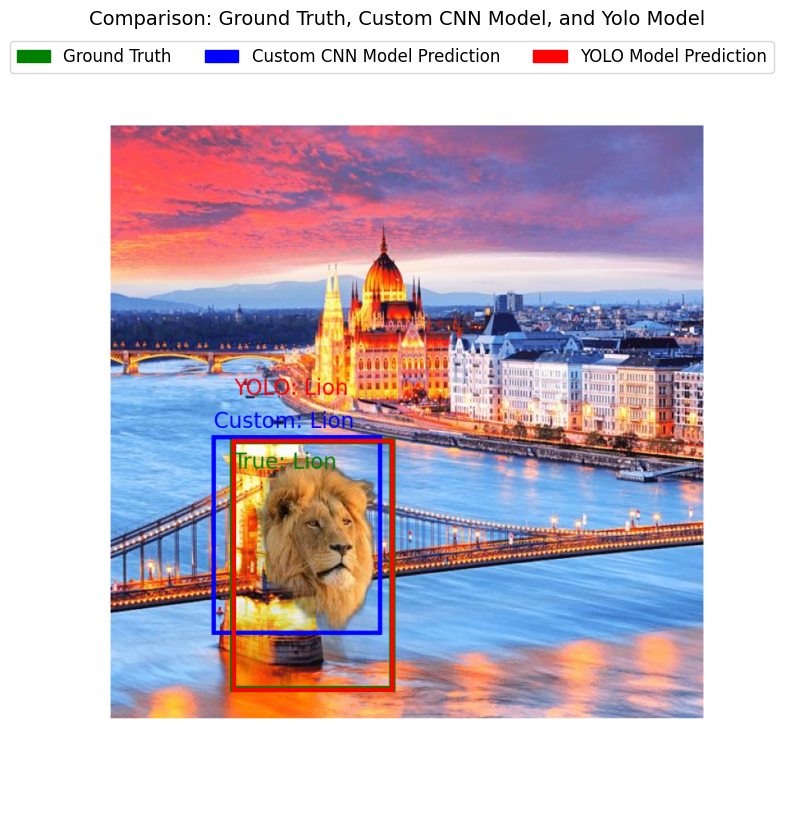

...

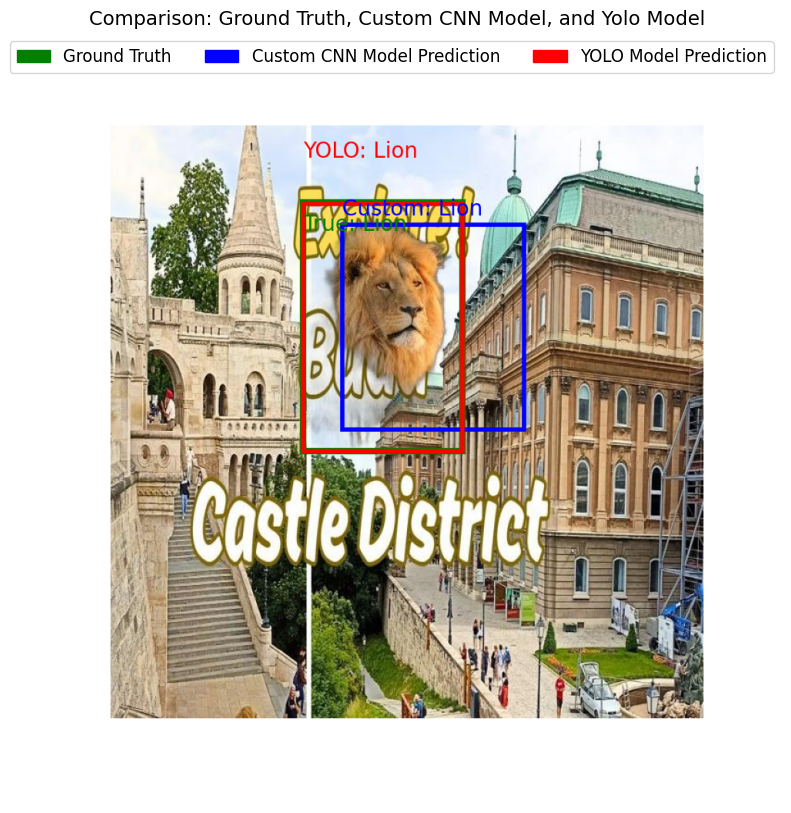

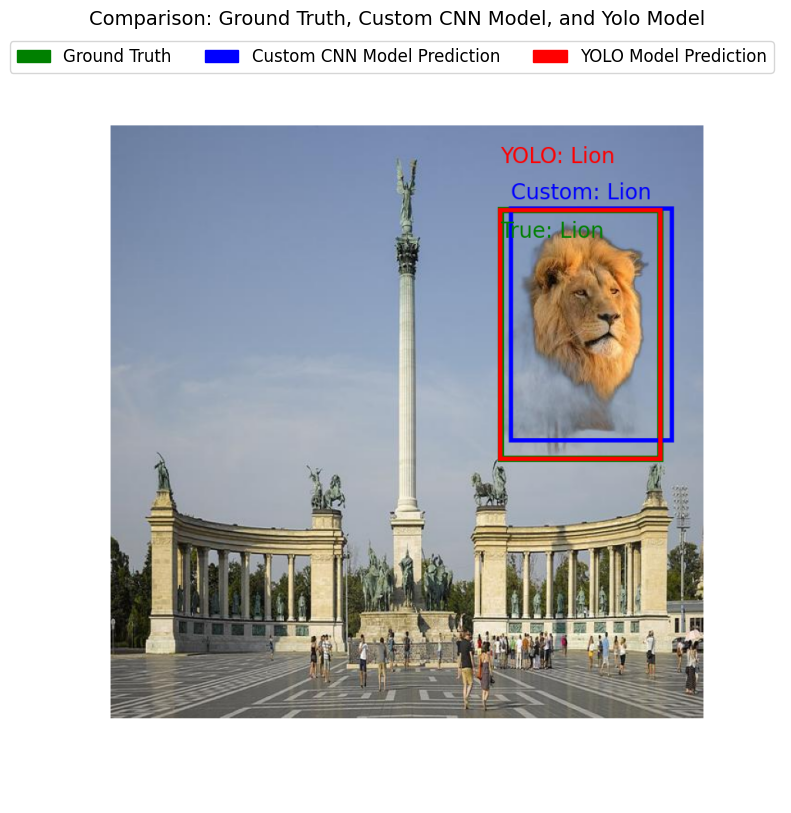

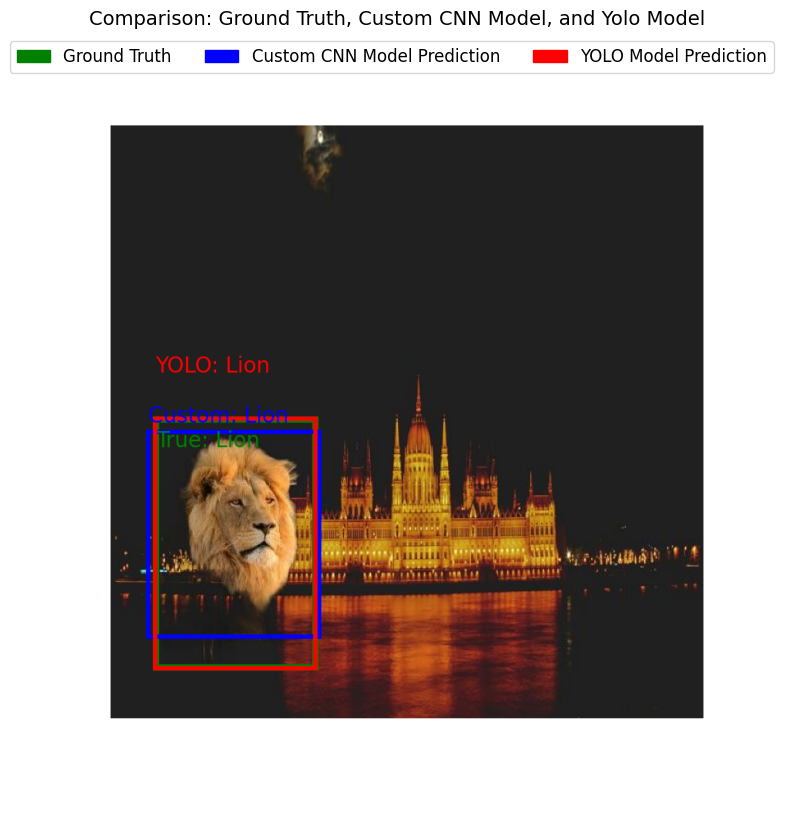

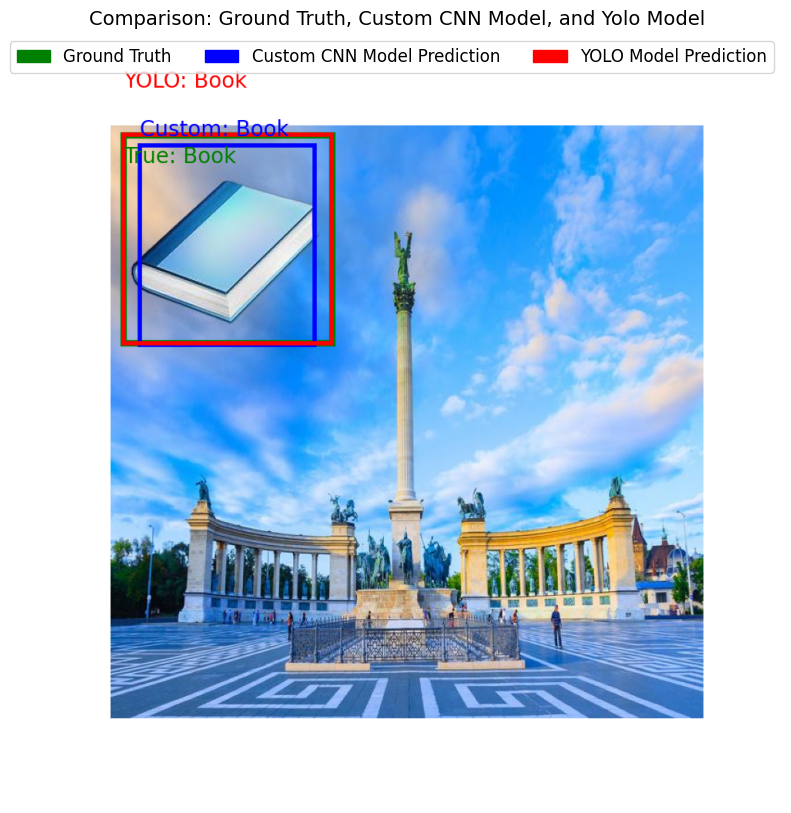

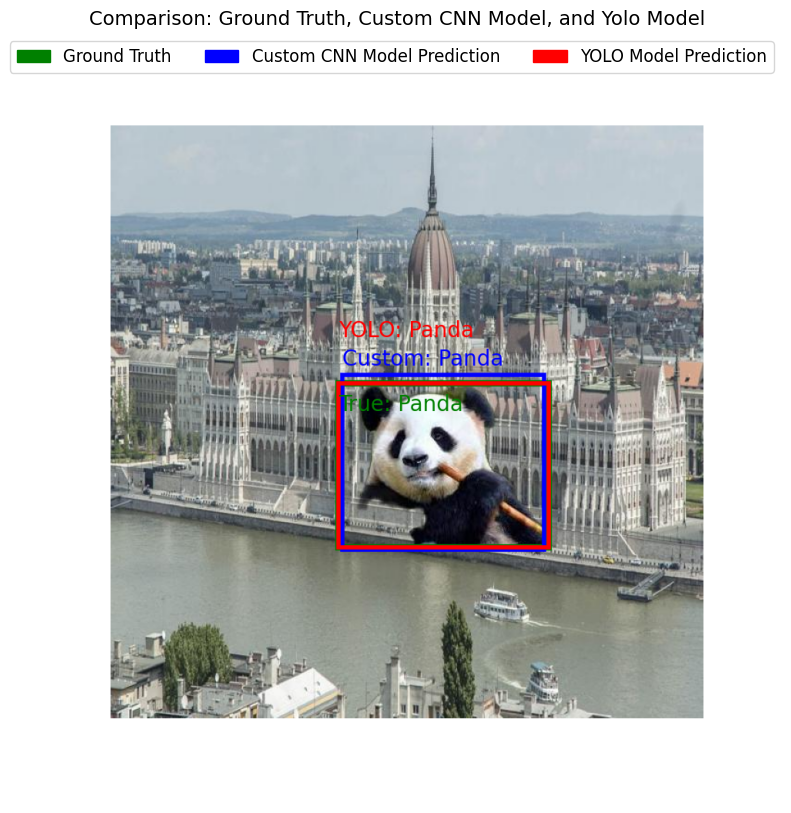

In [13]:
import matplotlib.pyplot as plt
import os
from PIL import Image
import matplotlib.patches as patches

# Path to the comparison results directory
compare_results_dir = '/home/syma/Documents/ELTE/DND/Final_Assignment/compare_results'

# Get the list of comparison images in the directory
comparison_images = [img for img in os.listdir(compare_results_dir) if img.endswith(('.png', '.jpg', '.jpeg'))]

# Sort and select the first 20 images
comparison_images = sorted(comparison_images)[:20]

# Loop through the selected comparison images and plot them one by one
for img_name in comparison_images:
    img_path = os.path.join(compare_results_dir, img_name)
    
    # Load the image
    img = Image.open(img_path)
    
    # Create a figure for each image
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Display the image
    ax.imshow(img)
    ax.axis('off')  # Hide axes 
    ax.set_title(f"Comparison: Ground Truth, Custom CNN Model, and Yolo Model", fontsize=14)

    # Add a legend for the bounding box colors
    legend_patches = [patches.Patch(color='green', label='Ground Truth'),
                      patches.Patch(color='blue', label='Custom CNN Model Prediction'),
                      patches.Patch(color='red', label='YOLO Model Prediction')]
    ax.legend(handles=legend_patches, loc='upper right', ncol=3,fontsize=12)

    # Show the image
    plt.show()
